**Import libraries and dependencies**

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
import matplotlib.font_manager as fm
import scanpy as sc
#import skimage #***********************
#import skmisc #***********************
import torch
import scvi
#import igraph #***********************
import scvelo as scv
import anndata
#import scipy.io #***********************
import re
#import tempfile #***********************
import seaborn as sns
#from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection #***********************************
#import ray
#from ray import tune
#from scvi import autotune


os.environ["CUDA_VISIBLE_DEVICES"] = "1"

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing CSCDataset from `anndata.experimental` is deprecated. Import anndata.abc.CSCDataset instead.
  warnings.warn(msg, Futur

In [2]:
# Matrix multiplication balancing precision and computational efficiency (options: medium-high-highest)
torch.set_float32_matmul_precision("high")

# Highest level of verbosity
sc.settings.verbosity = 3  
scv.settings.verbosity = 3

# Reproducibility
scvi.settings.seed = 1

# Figures
scv.set_figure_params(style="scvelo")

# Use Times New Roman as font
font_path = '/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/supp_data/misc/Times_New_Roman.ttf'
fm.fontManager.addfont(font_path)
prop = fm.FontProperties(fname=font_path)
pl.rcParams['font.family'] = 'sans-serif'
pl.rcParams['font.sans-serif'] = prop.get_name()

# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

Seed set to 1


In [3]:
# Select samples
os.chdir('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/1-2_scKB_mapping')
samples = ['0h_1_scKB','0h_2_scKB','2h_1_scKB','2h_2_scKB','4h_1_scKB','4h_2_scKB','10h_1_scKB','10h_2_scKB']

# Directory with multiple files required below
analysis_dir = '/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/supp_data/misc/'

In [4]:
# Read anndata objects and concatenate them
adatas = {}
for sample in samples:
    adata_path = f'/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/2-COPILOT/h5ad_files_spliced/{sample}_COPILOT.h5ad'
    adatas[sample] = anndata.read_h5ad(adata_path)

    print(adatas[sample])

adata = list(adatas.values())[0].concatenate(list(adatas.values())[1:],batch_key='sample',batch_categories=adatas.keys(),index_unique=None, join="outer")
adata.obs_names_make_unique()
del(adatas)

AnnData object with n_obs × n_vars = 8349 × 27643
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 6993 × 27795
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 10371 × 26845
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 11971 × 27086
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 9269 × 26937
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 8419 × 26885
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 5899 × 26313
    layers: 'spliced', 'unspliced'
AnnData object with n_obs × n_vars = 7830 × 26393
    layers: 'spliced', 'unspliced'


In [5]:
# Rename samples
adata.obs['batch'] = adata.obs['sample']
adata.obs['experiment'] = adata.obs['sample']
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('0h_'), '0h', adata.obs['experiment'])
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('2h_'), '2h', adata.obs['experiment'])
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('4h_'), '4h', adata.obs['experiment'])
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('10h_'), '10h', adata.obs['experiment'])
adata.obs['experiment'] = adata.obs['experiment'].astype('category')

In [6]:
# Read output of scVI_scANVI file to annotate cell types and developmental stages
adata_annotation = sc.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/MINI-EX_adata_all.h5ad')
print(adata_annotation)

AnnData object with n_obs × n_vars = 65218 × 30721
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental', '_scvi_batch', '_scvi_labels', 'final_annotation_celltype_0.7', 'final_annotation_celltype_0.8', 'final_annotation_celltype_0.9', 'unannotated_2_likely', 'unannotated_2_likely_merged', 'lineage_low_confidence', 'final_lineages', '_prediction', 'final_annotation_developmental_0.7', 'final_annotation_developmental_0.8', 'final_annotation_developmental_0.9', 'final_clustering', 'final_celltype', 'final_annotation_MINI-EX', 'number_final_annotation_MINI-EX'
    var: 'gene_symbol'


In [7]:
# Retrieve annotations
adata.obs["final_celltype"]=adata_annotation.obs["final_celltype"]
adata.obs["final_annotation_developmental_0.7"]=adata_annotation.obs["final_annotation_developmental_0.7"]
adata.obs["final_lineages"]=adata_annotation.obs["final_lineages"]
adata.obs["final_annotation_MINI-EX"]=adata_annotation.obs["final_annotation_MINI-EX"]

In [8]:
print(adata.obs['final_annotation_developmental_0.7'].value_counts())
print(adata.obs['final_celltype'].value_counts())
print(adata.obs['final_celltype'])
print(adata)

final_annotation_developmental_0.7
Meristem                     23045
Elongation                   17806
Maturation                    9371
Proximal Lateral Root Cap     8424
                              3147
Proximal Columella            1347
Distal Lateral Root Cap       1100
Distal Columella               978
Name: count, dtype: int64
final_celltype
Atrichoblast                   10455
Lateral Root Cap                9524
Xylem Pole Pericycle            8419
Trichoblast                     8339
Endodermis                      5952
Procambium                      5330
Cortex                          4225
Phloem Pole Pericycle           2922
Columella                       2325
Metaxylem                       1499
Metaphloem & Companion Cell     1433
Protoxylem                      1092
Protophloem                      488
Unknown0                         484
Unknown1                         439
Unknown2                         365
Unknown6                         357
Unknown4       

In [9]:
# Total number of cells
print(len(adata.obs["final_celltype"]))

# Create a mask to find rows where either of the specified columns has NA values (removed cells)
mask = adata.obs["final_celltype"].isna() | adata.obs["final_annotation_developmental_0.7"].isna()
adata = adata[~mask]

# Verify the number of remaining cells
print(len(adata.obs["final_celltype"]))

69101
65218


In [10]:
# Define the GTF file path
gtf_file = f'{analysis_dir}/genes.gtf'

# Dictionary to store gene_id -> gene_name mapping
gene_dict = {}

# Open and process the GTF file
with open(gtf_file, "r") as f:
    for line in f:
        if line.startswith("#"):  # Skip header lines
            continue

        fields = line.strip().split("\t")
        if fields[2] != "gene":  # Filter only "gene" entries
            continue

        # Extract attributes (last column)
        attributes = fields[8]

        # Use regex to extract gene_id and gene_name
        gene_id_match = re.search(r'gene_id "([^"]+)"', attributes)
        gene_name_match = re.search(r'gene_name "([^"]+)"', attributes)

        if gene_id_match and gene_name_match:
            gene_id = gene_id_match.group(1)  # Extract ATG ID (e.g., AT5G57620)
            gene_name = gene_name_match.group(1)  # Extract gene name (e.g., MYB36)
            gene_dict[gene_id] = gene_name  # Store in dictionary

# Print a preview
print({k: gene_dict[k] for k in list(gene_dict)[:100]})

# Assuming `adata` is your AnnData object
adata.var["gene_symbol"] = adata.var_names.map(gene_dict)

{'AT1G30814': 'AT1G30814', 'AT1G78930': 'AT1G78930', 'AT1G71695': 'AT1G71695', 'AT1G58983': 'AT1G58983', 'AT1G12980': 'ESR1', 'AT1G45223': 'AT1G45223', 'AT1G56250': 'PP2-B14', 'AT1G66852': 'AT1G66852', 'AT1G69810': 'WRKY36', 'AT1G72450': 'JAZ6', 'AT1G76280': 'AT1G76280', 'AT1G65630': 'DEG3', 'AT1G71390': 'RLP11', 'AT1G56233': 'AT1G56233', 'AT1G15210': 'ABCG35', 'AT1G15250': 'AT1G15250', 'AT1G79700': 'WRI4', 'AT1G62895': 'AT1G62895', 'AT1G73360': 'HDG11', 'AT1G16360': 'AT1G16360', 'AT1G10225': 'AT1G10225', 'AT1G26670': 'VTI1B', 'AT1G34855': 'AT1G34855', 'AT1G52200': 'AT1G52200', 'AT1G57800': 'VIM5', 'AT1G69460': 'AT1G69460', 'AT1G04310': 'ERS2', 'AT1G08080': 'ACA7', 'AT1G75550': 'AT1G75550', 'AT1G71890': 'SUC5', 'AT1G05430': 'AT1G05430', 'AT1G80870': 'AT1G80870', 'AT1G75310': 'AUL1', 'AT1G02010': 'SEC1A', 'AT1G47900': 'AT1G47900', 'AT1G14315': 'AT1G14315', 'AT1G26760': 'SDG35', 'AT1G05250': 'AT1G05250', 'AT1G67260': 'TCP1', 'AT1G24575': 'AT1G24575', 'AT1G12790': 'AT1G12790', 'AT1G04850'

In [11]:
adata.raw = adata.copy()

In [12]:
# Remove mitochondrial, chloroplast and protoplasting-associated genes
mito_genes = adata.var_names.str.startswith("ATMG")  # Mitochondrial genes
chloro_genes = adata.var_names.str.startswith("ATCG")  # Chloroplast genes

# Define protoplasting-induced genes
pp_genes = pd.read_csv(f'{analysis_dir}/Protoplasting_DEgene_FC2_list.txt', header=None)[0].tolist()
pp_genes_mask = adata.var_names.isin(pp_genes)  # Find matching genes

# Combine all masks
genes_to_remove = mito_genes | chloro_genes | pp_genes_mask

# Filter out these genes
adata = adata[:, ~genes_to_remove].copy()

# Check the remaining number of genes
print(f"Remaining genes: {adata.n_vars}")

Remaining genes: 27097


In [13]:
# Get gene names present in spliced and unspliced layers
genes_spliced = set(adata.var_names[np.array((adata.layers["spliced"].sum(axis=0) > 0)).flatten()])
genes_unspliced = set(adata.var_names[np.array((adata.layers["unspliced"].sum(axis=0) > 0)).flatten()])

# Find common genes
common_genes = list(genes_spliced & genes_unspliced)

# Subset AnnData to keep only common genes
adata = adata[:, common_genes]

print(f"Remaining genes: {adata.n_vars}")

Remaining genes: 18456


In [14]:
# Reorder experiments for the plot
custom_order = ['0h', '2h', '4h', '10h']
adata.obs["experiment"] = adata.obs["experiment"].astype("category") # Ensure 'experiment' is a categorical variable
adata.obs["experiment"].cat.reorder_categories(custom_order, inplace=True)

In [15]:
# Plot without showing it
scv.pl.proportions(adata, groupby='experiment', layers=['spliced', 'unspliced'], figsize=(16, 5), fontsize=10, show=False, dpi=600)

# Access current axis
ax = pl.gca()

# Loop through the bar label texts and modify them
for text in ax.texts:
    try:
        # Convert label text to float, divide by 100 to get proportion
        value = float(text.get_text().replace('%', '').strip())
        proportion = value / 100
        # Update the text label
        text.set_text(f"{proportion:.2f}")
        text.set_fontsize(10)
    except:
        continue

# Change axis label
ax.set_xlabel("Proportions", fontsize=12)
ax.set_ylabel("")

# Set axis tick label size
ax.tick_params(axis='x', labelsize=11)
ax.tick_params(axis='y', labelsize=11)

# Show plot
pl.tight_layout()
pl.show()

In [16]:
adata.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scvelo_preprocessing.h5ad')

In [4]:
adata = anndata.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scvelo_preprocessing.h5ad')

final_annotation_developmental_0.7
    369
Name: count, dtype: int64
Filtered out 13630 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing PCA
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
recovering dynamics (using 40/96 cores)


    finished (0:00:17) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 40/96 cores)
    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:00)


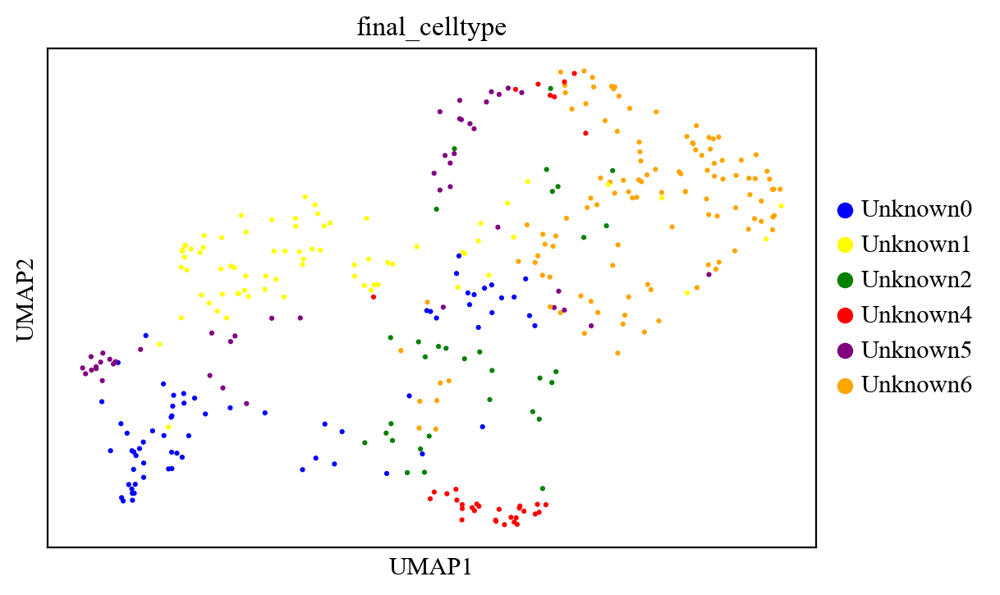

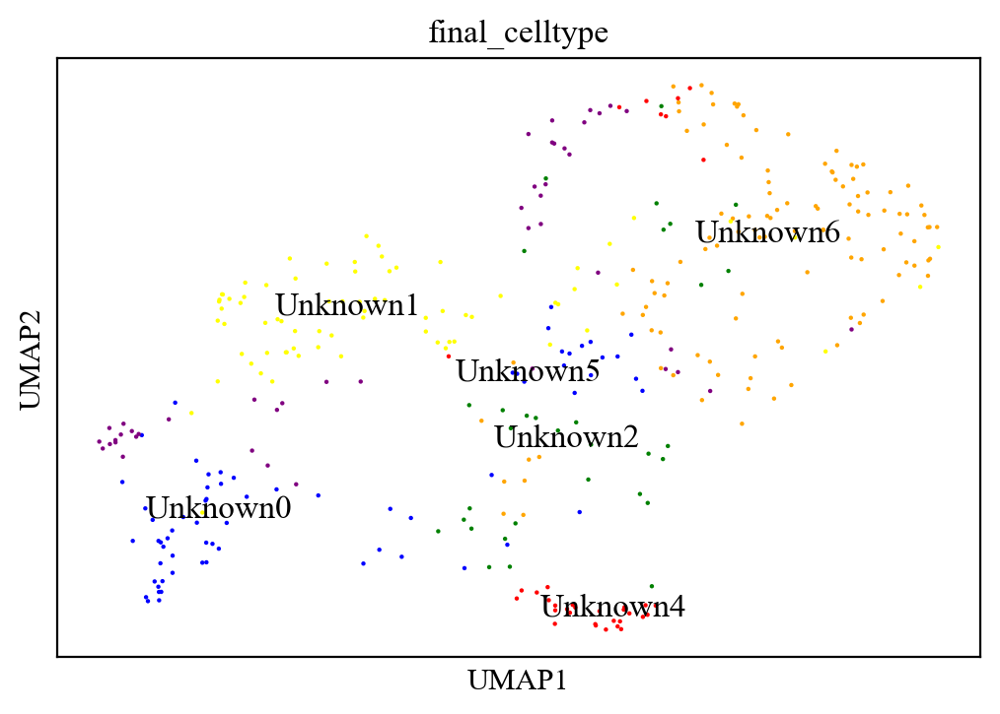

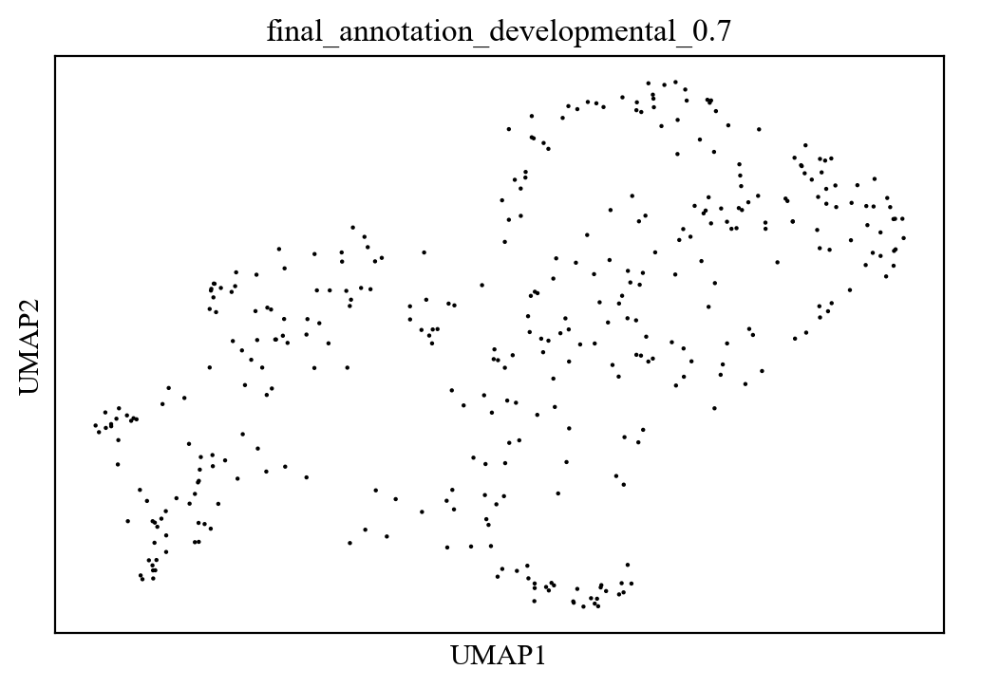

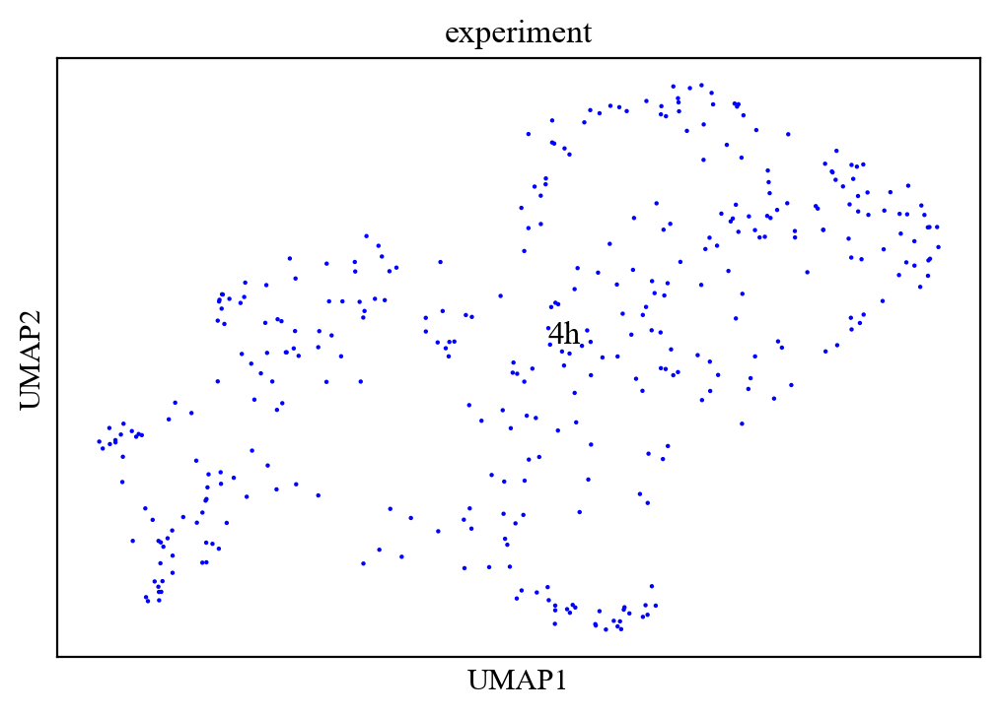

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

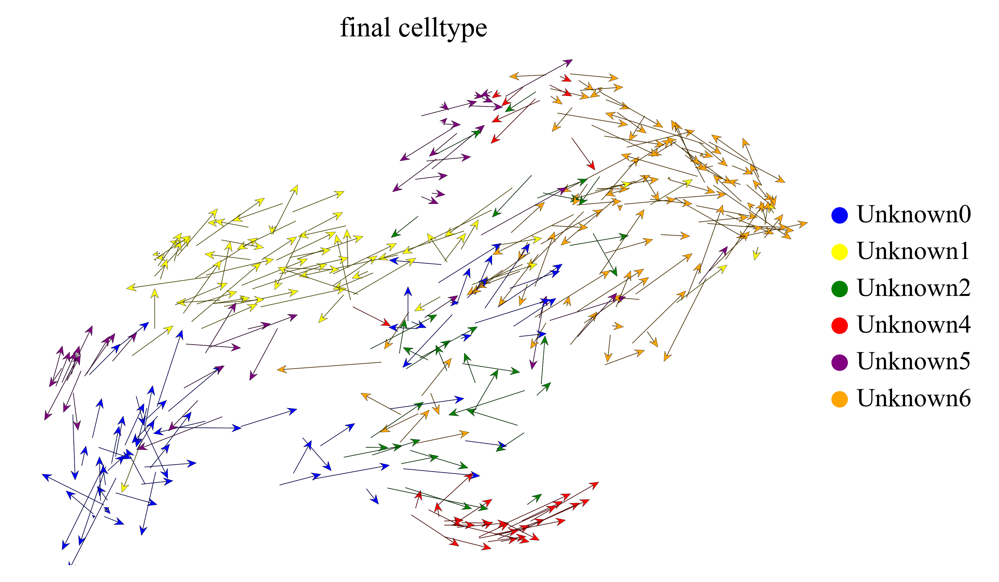

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

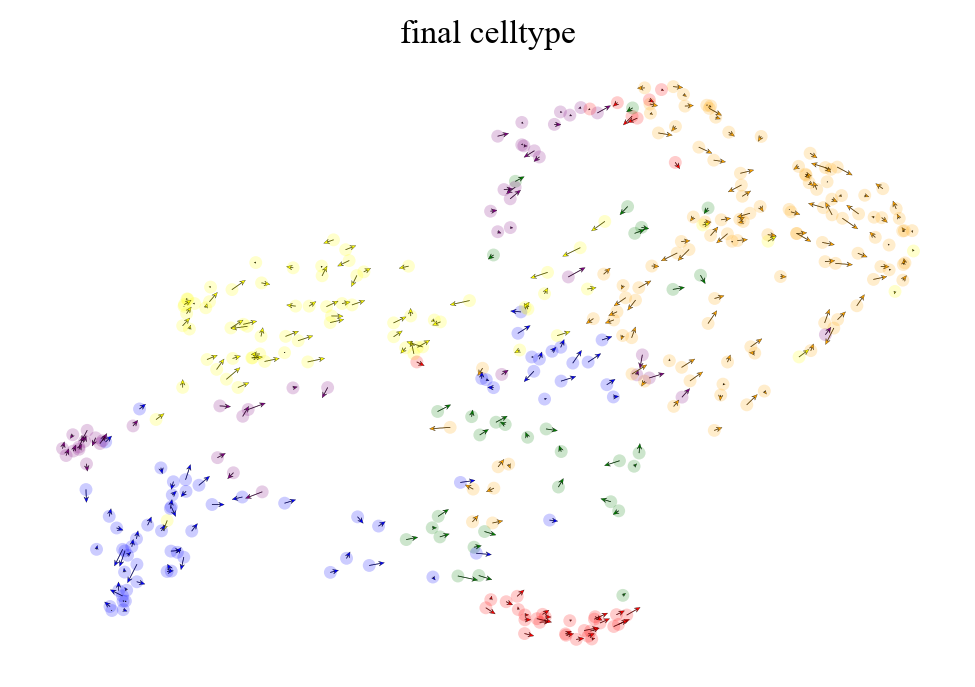

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

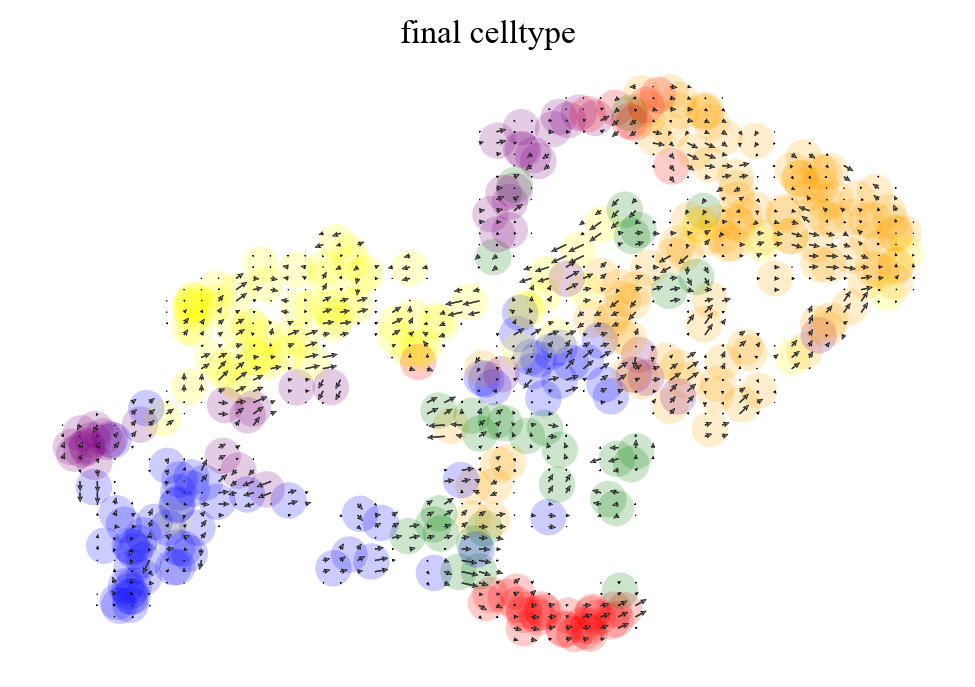

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

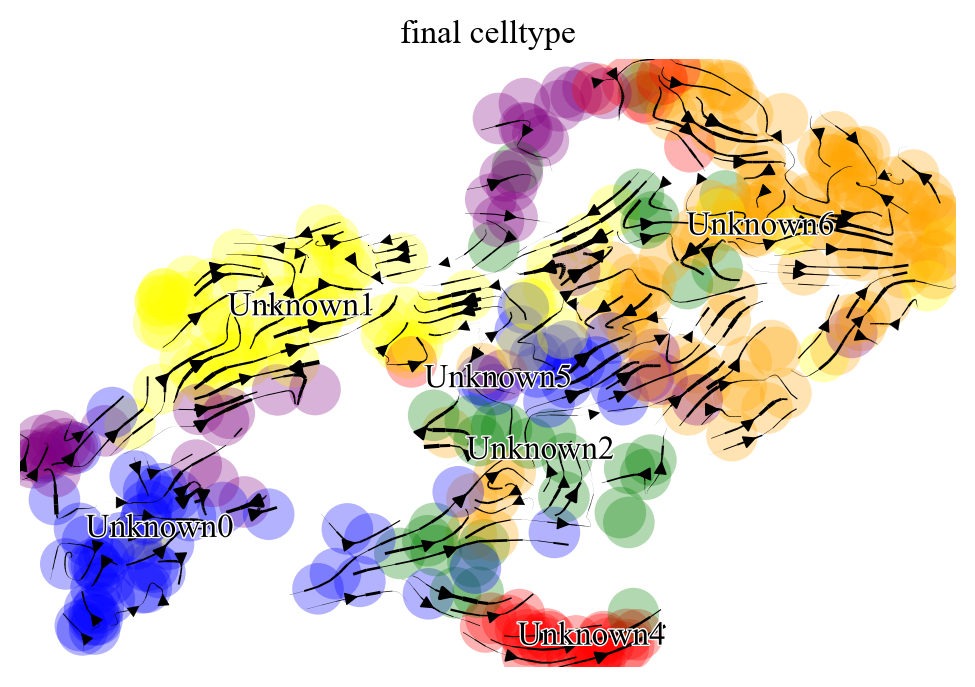

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

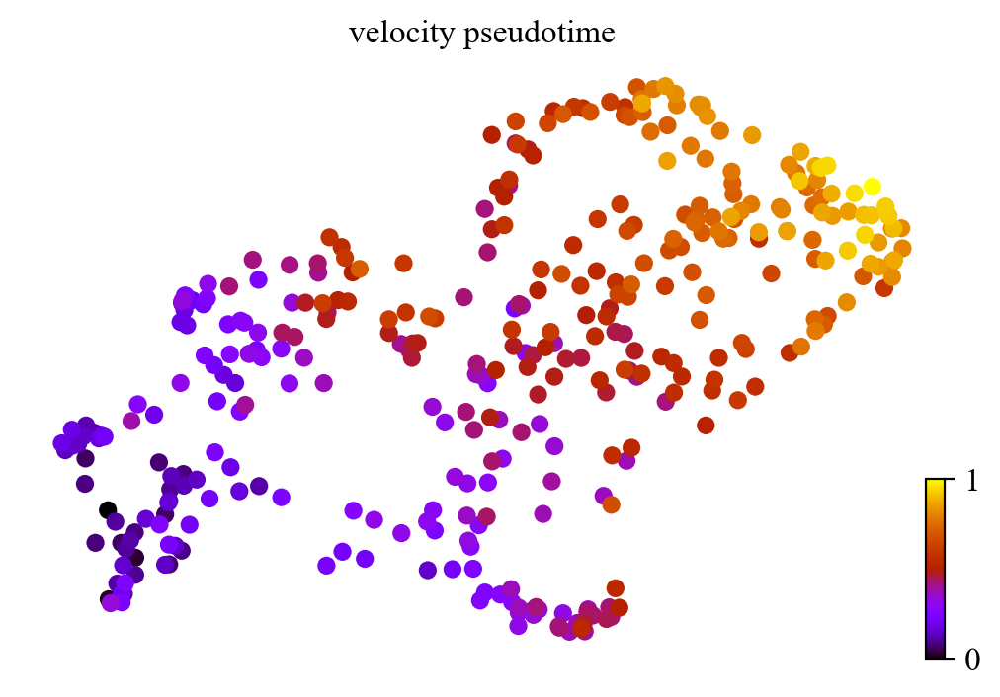

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

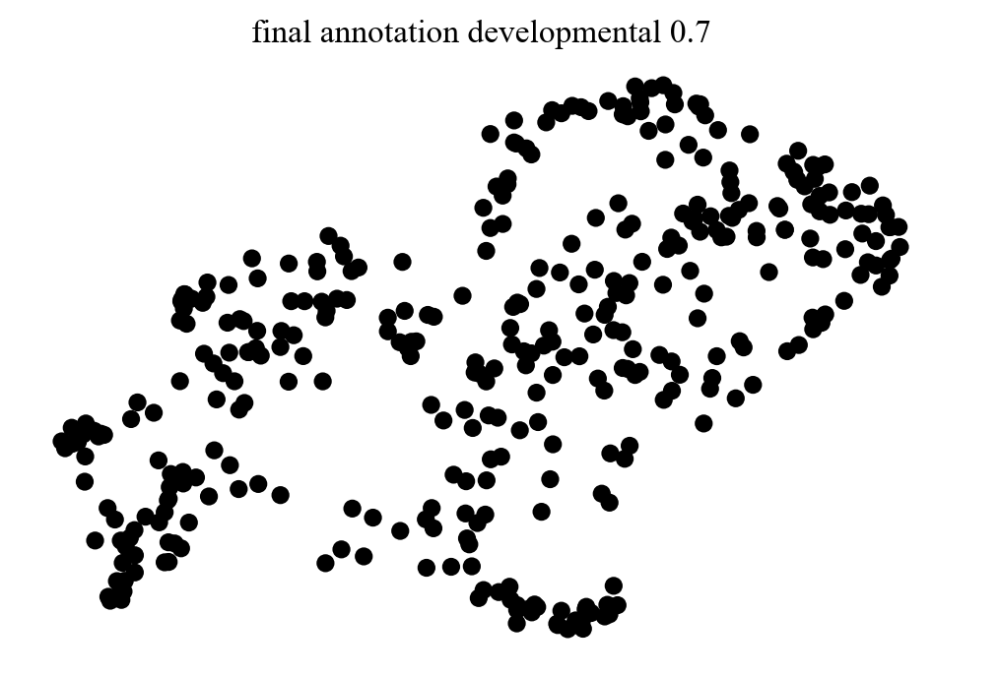

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:65: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return cat(data)  # if data is categorical/array
/lustr

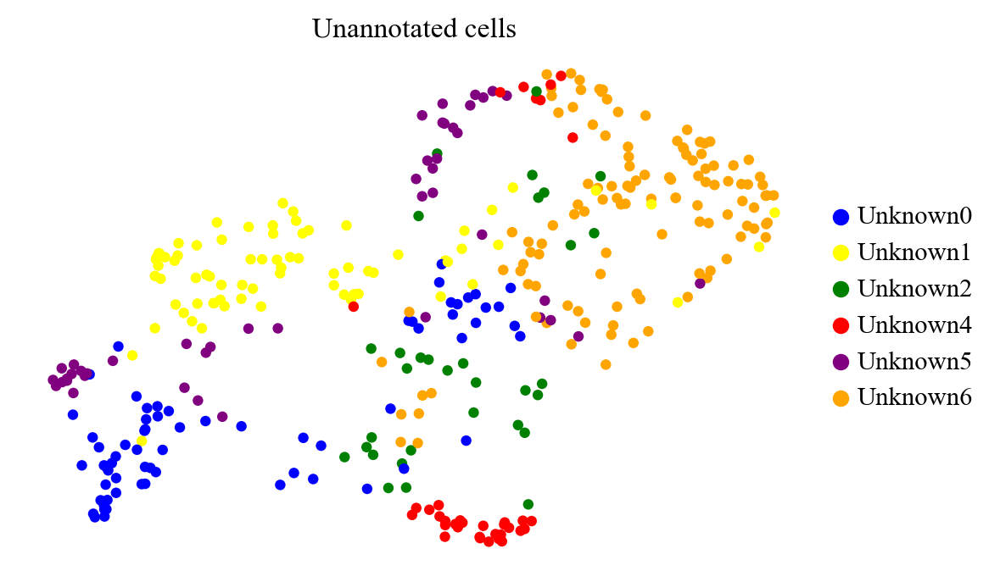

recovering dynamics (using 50/96 cores)
    finished (0:00:16) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


<Axes: title={'center': 'Latent time'}, xlabel='UMAP1', ylabel='UMAP2'>

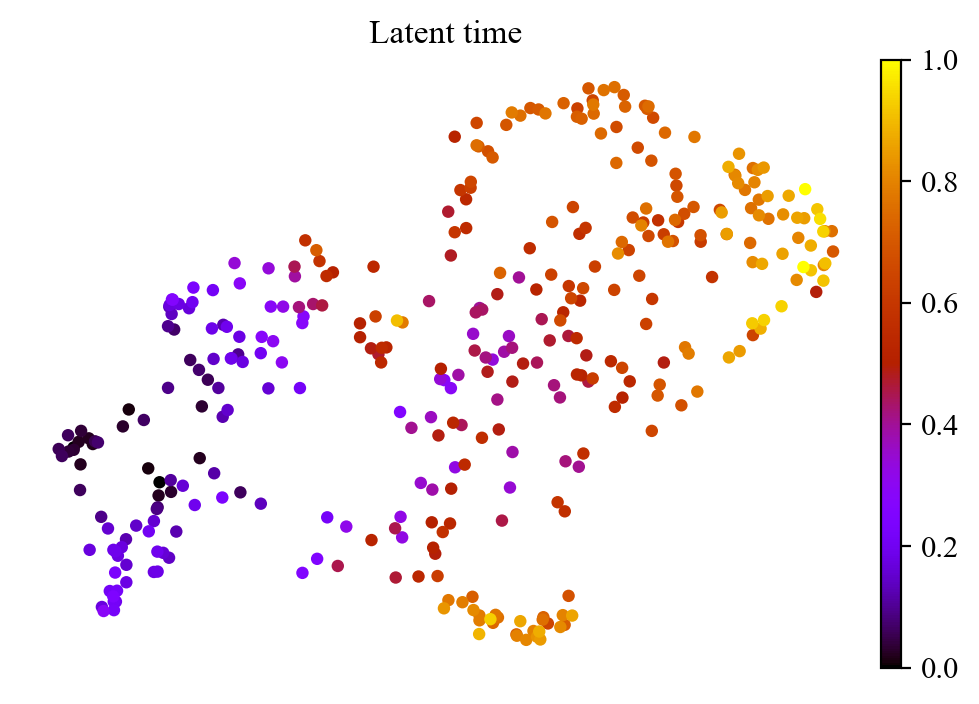

In [11]:
# Keep Unknown 0, 1, 2, 4, 5 and 6
filtered_mask_07 = (adata.obs["final_celltype"] == "Unknown0") | (adata.obs["final_celltype"] == "Unknown1") | (adata.obs["final_celltype"] == "Unknown2") | \
(adata.obs["final_celltype"] == "Unknown4") | (adata.obs["final_celltype"] == "Unknown5") | (adata.obs["final_celltype"] == "Unknown6")
adata_filtered_07 = adata[filtered_mask_07].copy()

# Keep 4h
adata_10h = adata_filtered_07[adata_filtered_07.obs['experiment'].isin(['4h'])].copy()
print(adata_10h.obs["final_annotation_developmental_0.7"].value_counts())

# Filter and normalize
scv.pp.filter_and_normalize(adata_10h, min_shared_counts=20, n_top_genes=2000)

# PCA and NN graph
sc.pp.pca(adata_10h, n_comps=30)
sc.pp.neighbors(adata_10h, n_pcs=30, n_neighbors=30, random_state=0)

# RNA velocity with dynamical mode
scv.tl.recover_dynamics(adata_10h, n_jobs=40)
scv.tl.velocity(adata_10h, mode="dynamical")
scv.tl.velocity_graph(adata_10h, n_jobs=40)

sc.tl.umap(adata_10h, min_dist=0.1)

custom_palette = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",
    "Unknown0": "blue",
    "Unknown1": "yellow", 
    "Unknown2": "green",
    "Unknown3": "pink",
    "Unknown4": "red",
    "Unknown5": "purple",
    "Unknown6": "orange",
    "Unknown7": "magenta",
    "Unknown8": "olive",
    "Unknown9": "black",
    "Unknown10": "khaki",
    "Unknown11": "darkslategrey"
}

custom_palette_developmental = {
        "Distal Columella": "#E69F00", 
        "Proximal Columella": "#56B4E9", 
        "Distal Lateral Root Cap": "#009E73", 
        "Proximal Lateral Root Cap": "#F0E442", 
        "Meristem": "#0072B2", 
        "Elongation": "#D55E00", 
        "Maturation": "#CC79A7",
        "": "#000000" 
}

sc.pl.umap(adata_10h, color="final_celltype", size=20, palette=custom_palette)
sc.pl.umap(adata_10h, color="final_celltype", size=10, palette=custom_palette, legend_loc="on data")
sc.pl.umap(adata_10h, color="final_annotation_developmental_0.7", size=10, palette=custom_palette_developmental)
sc.pl.umap(adata_10h, color="experiment", size=10, palette=['blue', 'yellow', 'pink', 'green', 'orange'], legend_loc="on data")

# Multiple plots (different format, variables, etc)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', legend_loc ='right margin', color = "final_celltype", size = 1, arrow_length=6, arrow_size=2, dpi=300)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_grid(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_stream(adata_10h, basis='X_umap', color="final_celltype")

scv.tl.velocity_pseudotime(adata_10h)
scv.pl.scatter(adata_10h, color='velocity_pseudotime', cmap='gnuplot')
scv.pl.scatter(adata_10h, color='final_annotation_developmental_0.7', cmap='gnuplot', legend_loc="right")
scv.pl.scatter(adata_10h, color='final_celltype', palette=custom_palette, legend_loc="right margin", title="Unannotated cells", size=80)

scv.tl.recover_dynamics(adata_10h, n_jobs=50)
scv.tl.latent_time(adata_10h)
sc.pl.umap(adata_10h, color='latent_time', show=False, frameon=False, color_map="gnuplot", title="Latent time", size=80)

In [16]:
# Group by 'final_celltype' and calculate the mean latent_time
average_latent_time = adata_10h.obs.groupby("final_celltype")["latent_time"].mean()
print(average_latent_time)

final_celltype
Unknown0    0.242712
Unknown1    0.363718
Unknown2    0.517904
Unknown4    0.771633
Unknown5    0.355102
Unknown6    0.716187
Name: latent_time, dtype: float64


**RNA velocity validation with real time**

final_annotation_developmental_0.7
Proximal Lateral Root Cap    4892
Name: count, dtype: int64


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Epoch 100/100: 100%|██████████| 100/100 [01:16<00:00,  1.47it/s, v_num=1, train_loss_step=8.79e+3, train_loss_epoch=9.07e+3]

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [01:16<00:00,  1.31it/s, v_num=1, train_loss_step=8.79e+3, train_loss_epoch=9.07e+3]
Filtered out 8680 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
recovering dynamics (using 40/96 cores)
    finished (0:00:42) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing PCA
    with n_comps=30


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/tools/velocity.py:326: DeprecationWarning: Automatic neighbor calculation is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors first with Scanpy.
  moments(adata)
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/moments.py:71: DeprecationWarning: `neighbors` is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors with Scanpy.
  neighbors(
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/neighbors.py:233: DeprecationWarning: Automatic computation of PCA is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute PCA with Scanpy first.
  _set_pca(adata=adata, n_pcs=n_pcs, use_highly_variable=use_highly_variable)


    finished (0:00:01)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 40/96 cores)
    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)


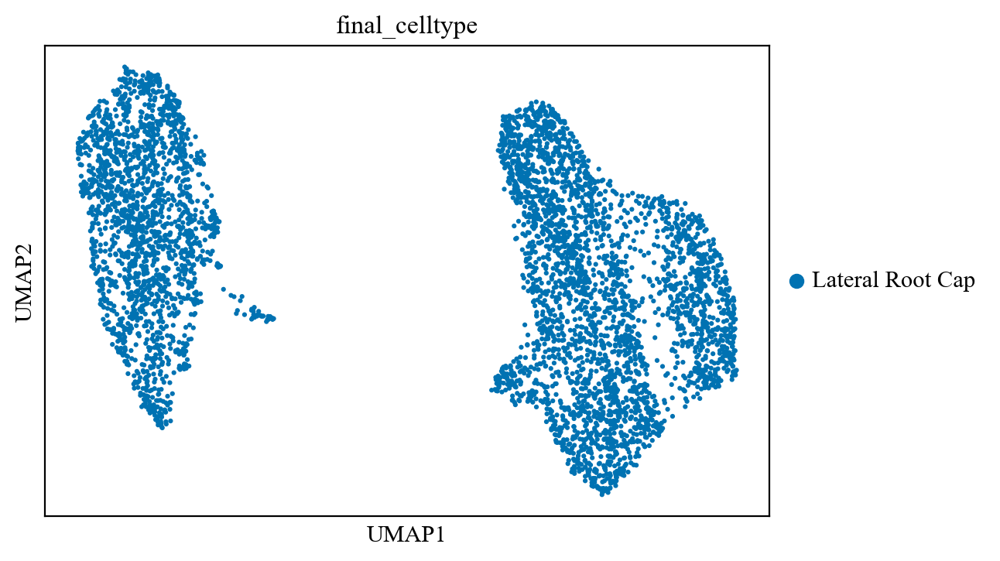

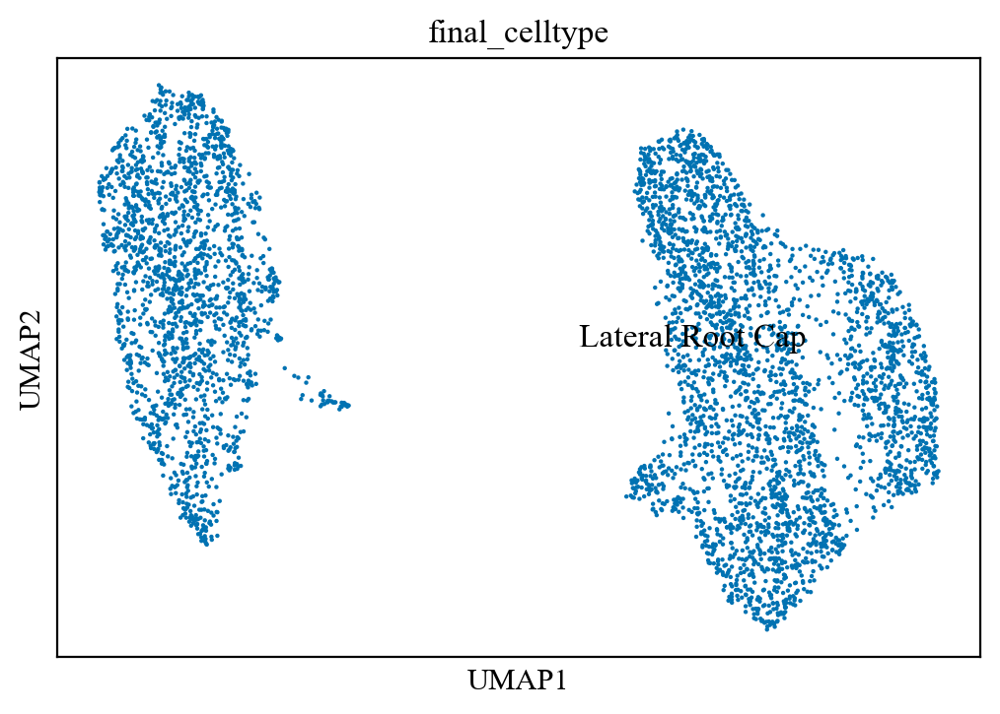

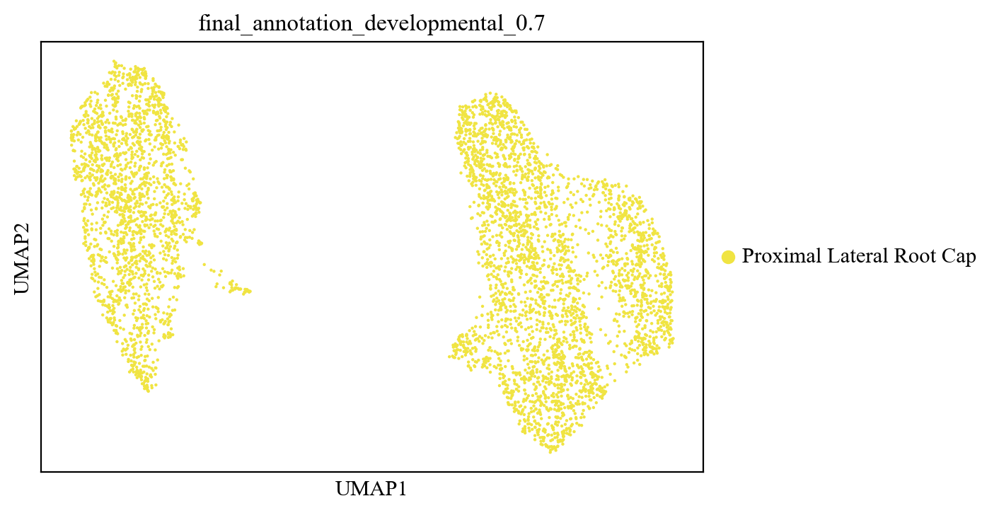

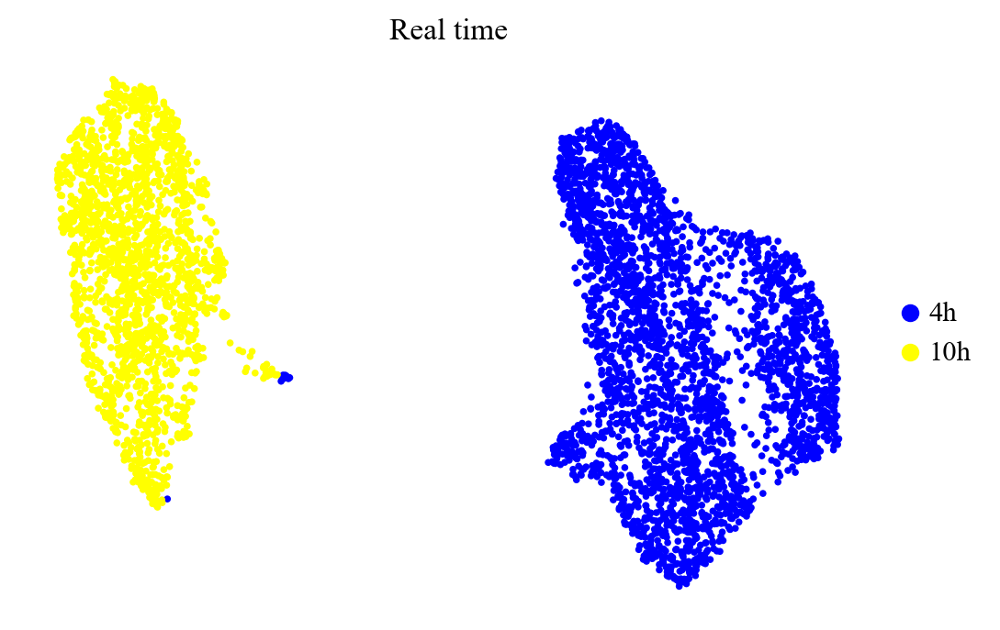

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

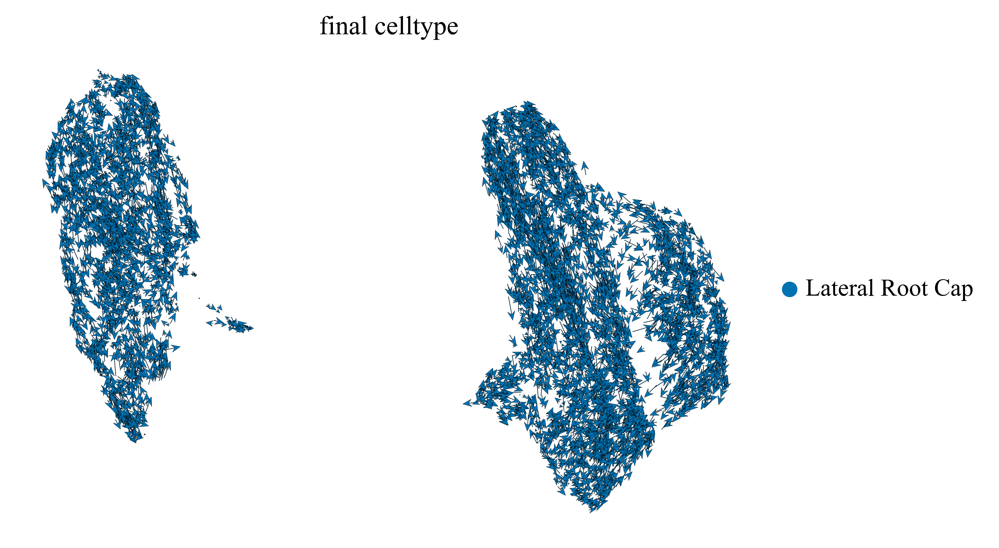

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

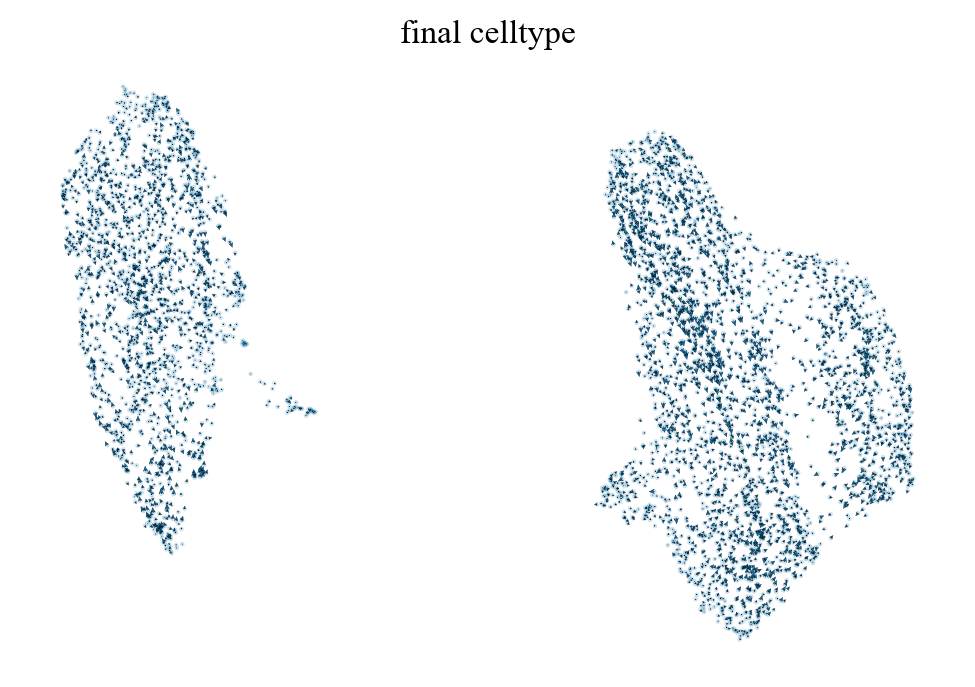

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

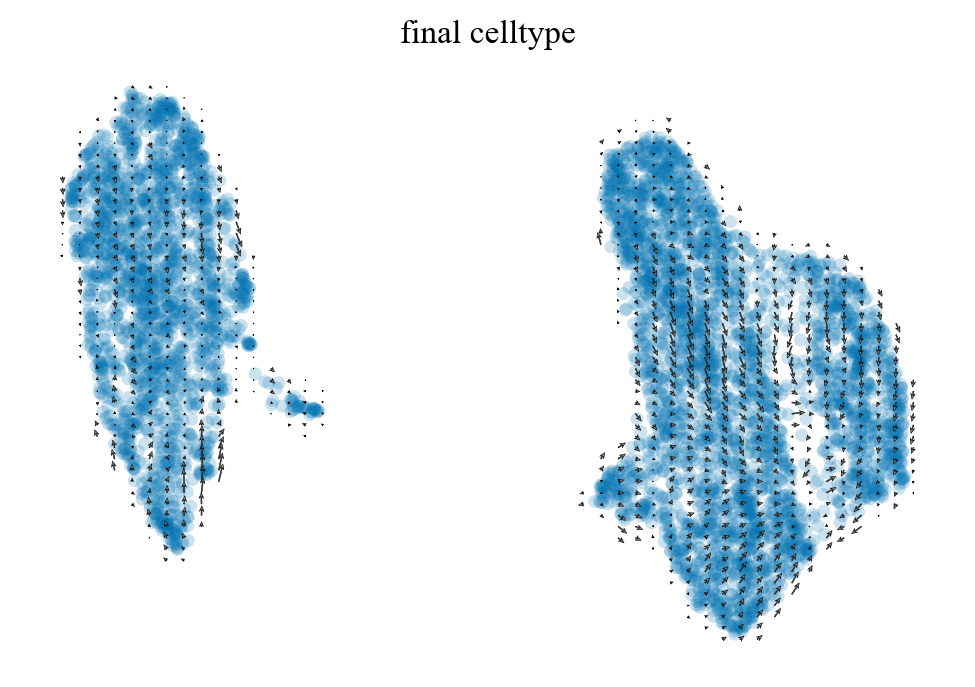

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

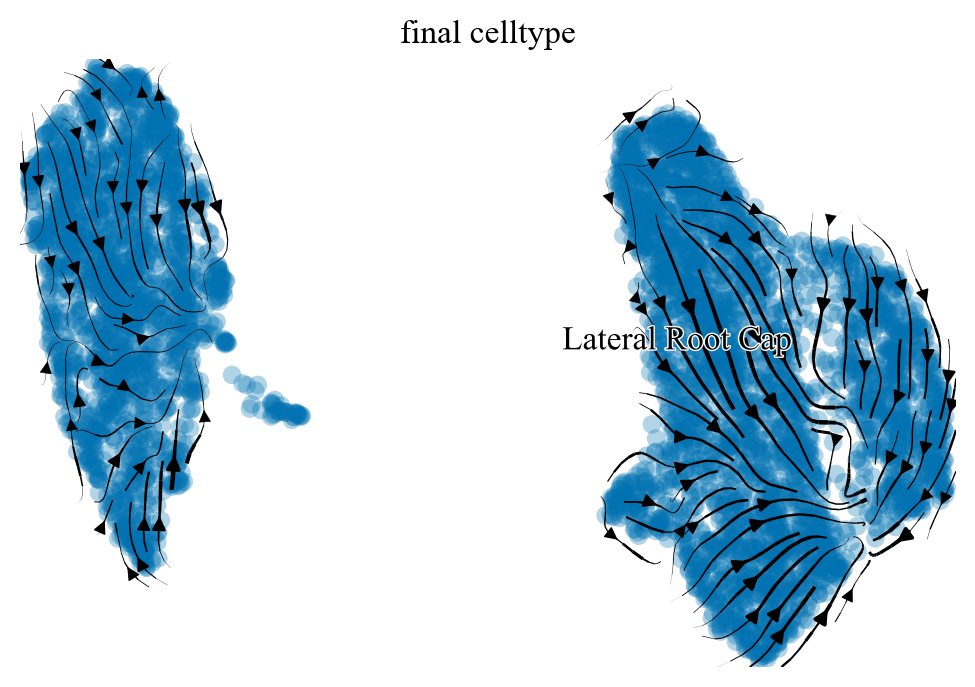

computing terminal states
    identified 2 regions of root cells and 2 regions of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

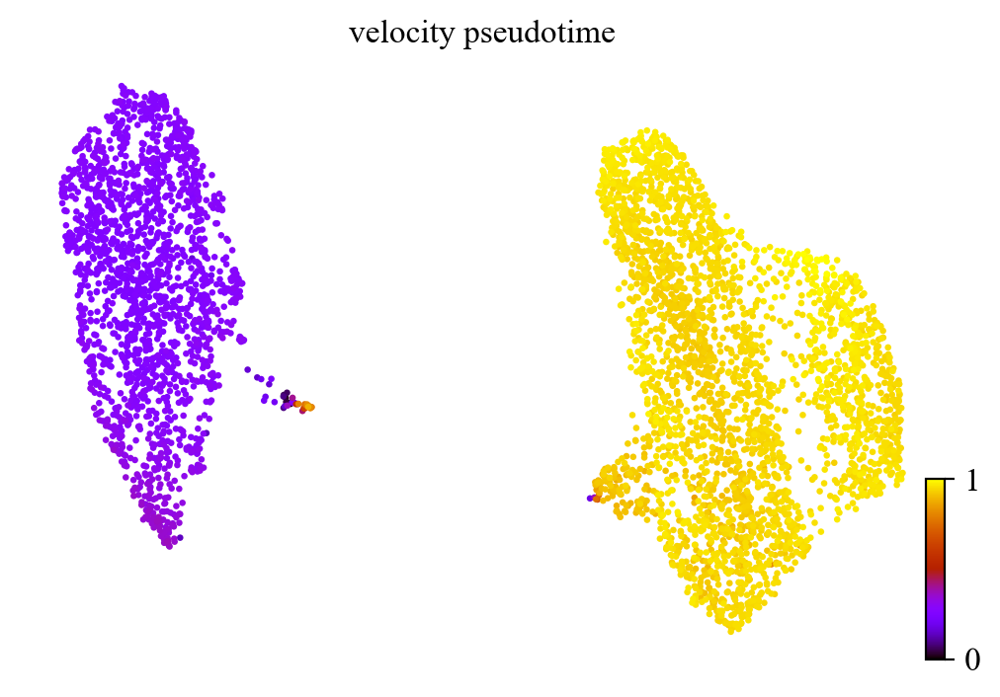

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

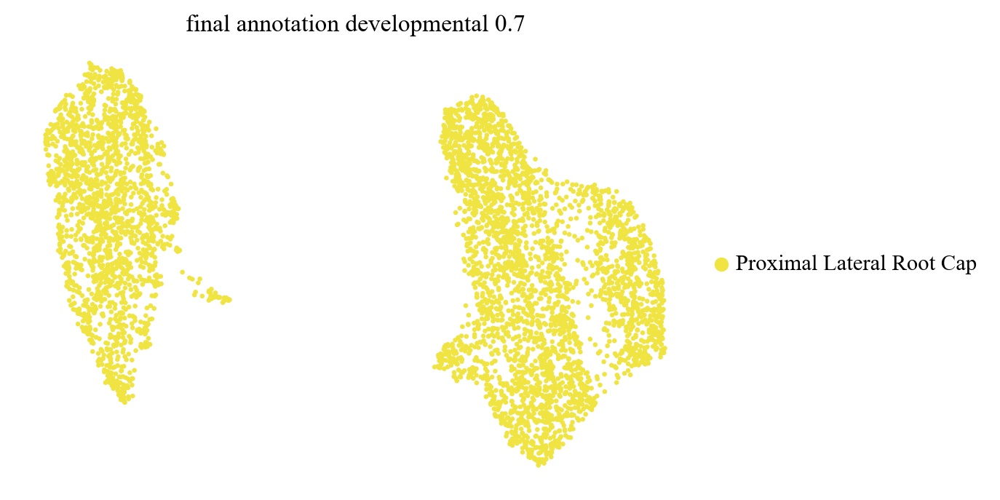

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:65: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return cat(data)  # if data is categorical/array
/lustr

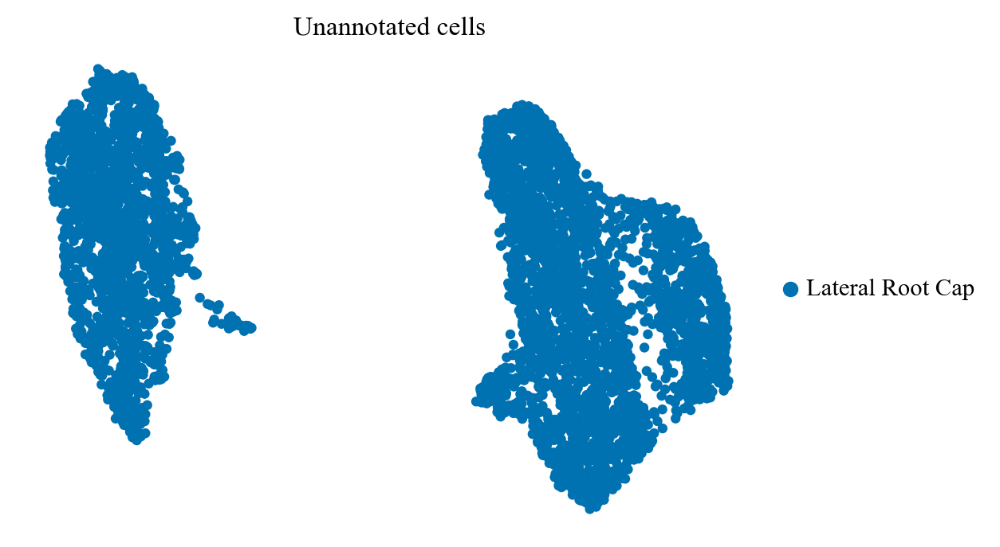

recovering dynamics (using 50/96 cores)
    finished (0:00:48) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


<Axes: title={'center': 'Latent time'}, xlabel='UMAP1', ylabel='UMAP2'>

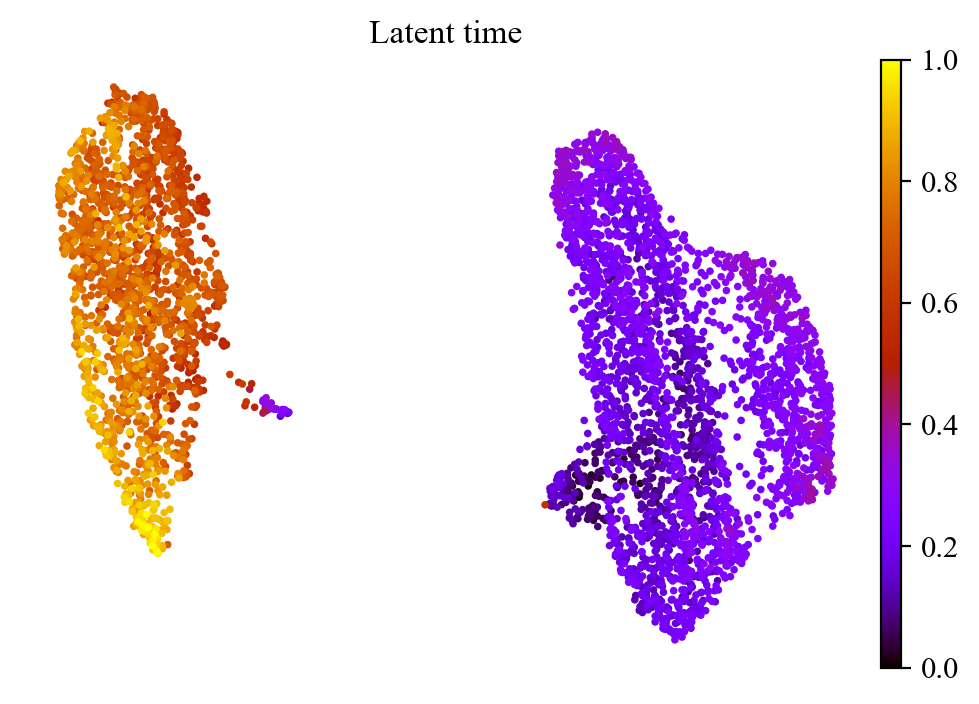

In [15]:
# Keep Unknown 0, 1, 2, 4, 5 and 6
filtered_mask_07 = (adata.obs["final_celltype"] == "Lateral Root Cap") & (adata.obs["final_annotation_developmental_0.7"] == "Proximal Lateral Root Cap")
adata_filtered_07 = adata[filtered_mask_07].copy()

# Keep 4h
adata_10h = adata_filtered_07[adata_filtered_07.obs['experiment'].isin(['4h', '10h'])].copy()
print(adata_10h.obs["final_annotation_developmental_0.7"].value_counts())

# Remove batch effects
scvi.model.SCVI.setup_anndata(adata_10h, batch_key='sample')
model = scvi.model.SCVI(adata_10h, n_layers=2, n_latent=30, gene_likelihood="nb")

model.to_device("cuda:0")  # Moves model to the first available GPU (which is now GPU 1)
model.train(max_epochs=100, check_val_every_n_epoch=1)

latent = model.get_latent_representation()
adata_10h.obsm['X_scVI'] = latent
adata_10h.layers['scVI'] = model.get_normalized_expression(library_size=1e4)

# Filter and normalize
scv.pp.filter_and_normalize(adata_10h, min_shared_counts=20, n_top_genes=2000)

# PCA and NN graph
#sc.pp.pca(adata_10h, n_comps=30)
sc.pp.neighbors(adata_10h, random_state=0, use_rep="X_scVI")

# RNA velocity with dynamical mode
scv.tl.recover_dynamics(adata_10h, n_jobs=40)
scv.tl.velocity(adata_10h, mode="dynamical")
scv.tl.velocity_graph(adata_10h, n_jobs=40)

sc.tl.umap(adata_10h, min_dist=0.3)

custom_palette = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",
    "Unknown0": "blue",
    "Unknown1": "yellow", 
    "Unknown2": "green",
    "Unknown3": "pink",
    "Unknown4": "red",
    "Unknown5": "purple",
    "Unknown6": "orange",
    "Unknown7": "magenta",
    "Unknown8": "olive",
    "Unknown9": "black",
    "Unknown10": "khaki",
    "Unknown11": "darkslategrey"
}

custom_palette_developmental = {
        "Distal Columella": "#E69F00", 
        "Proximal Columella": "#56B4E9", 
        "Distal Lateral Root Cap": "#009E73", 
        "Proximal Lateral Root Cap": "#F0E442", 
        "Meristem": "#0072B2", 
        "Elongation": "#D55E00", 
        "Maturation": "#CC79A7",
        "": "#000000" 
}

sc.pl.umap(adata_10h, color="final_celltype", size=20, palette=custom_palette)
sc.pl.umap(adata_10h, color="final_celltype", size=10, palette=custom_palette, legend_loc="on data")
sc.pl.umap(adata_10h, color="final_annotation_developmental_0.7", size=10, palette=custom_palette_developmental)
sc.pl.umap(adata_10h, color="experiment", size=30, palette=['blue', 'yellow', 'pink', 'green', 'orange'], legend_loc="right margin", frameon=False, title="Real time")

# Multiple plots (different format, variables, etc)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', legend_loc ='right margin', color = "final_celltype", size = 1, arrow_length=6, arrow_size=2, dpi=300)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_grid(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_stream(adata_10h, basis='X_umap', color="final_celltype")

scv.tl.velocity_pseudotime(adata_10h)
scv.pl.scatter(adata_10h, color='velocity_pseudotime', cmap='gnuplot')
scv.pl.scatter(adata_10h, color='final_annotation_developmental_0.7', cmap='gnuplot', legend_loc="right")
scv.pl.scatter(adata_10h, color='final_celltype', palette=custom_palette, legend_loc="right margin", title="Unannotated cells", size=80)

scv.tl.recover_dynamics(adata_10h, n_jobs=50)
scv.tl.latent_time(adata_10h)
sc.pl.umap(adata_10h, color='latent_time', show=False, frameon=False, color_map="gnuplot", title="Latent time", size=30)

**RNA velocity validation with developmental stages**

final_annotation_developmental_0.7
Elongation    1545
Meristem      1083
Maturation     936
Name: count, dtype: int64
Filtered out 9792 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing PCA
    with n_comps=30


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
recovering dynamics (using 40/96 cores)
    finished (0:00:25) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 40/96 cores)
    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:04)


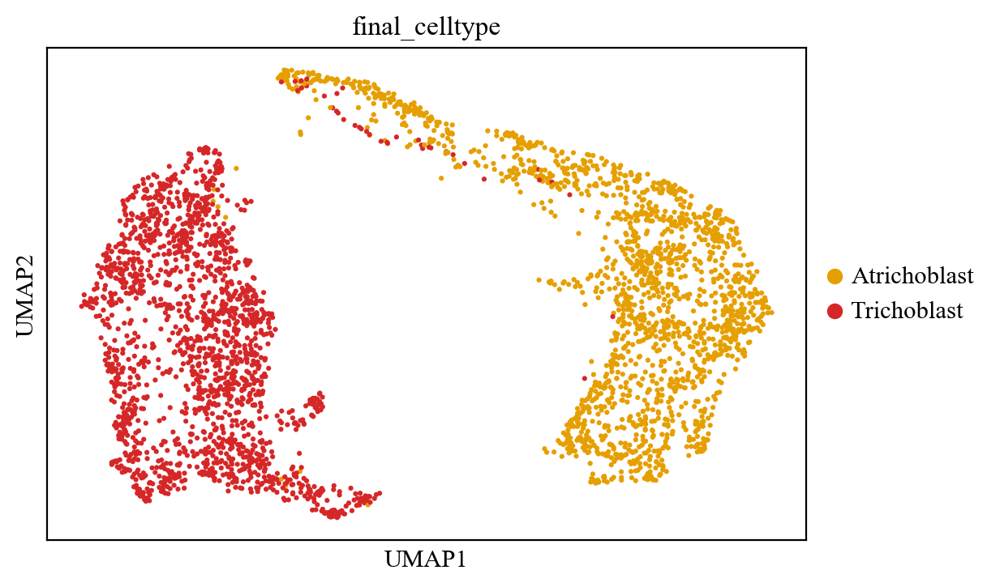

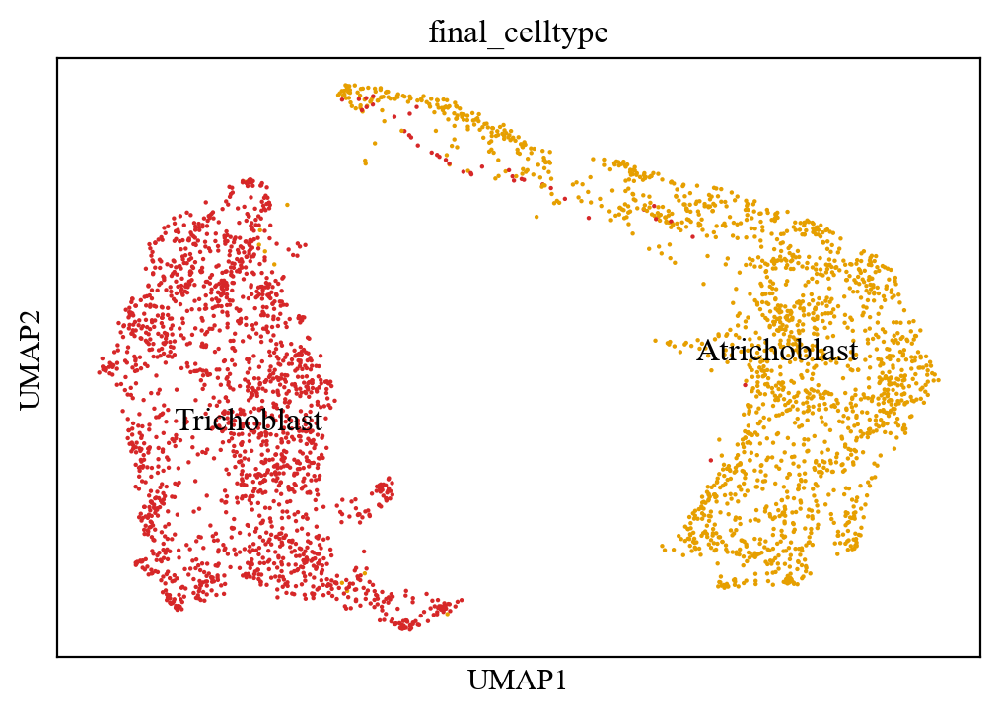

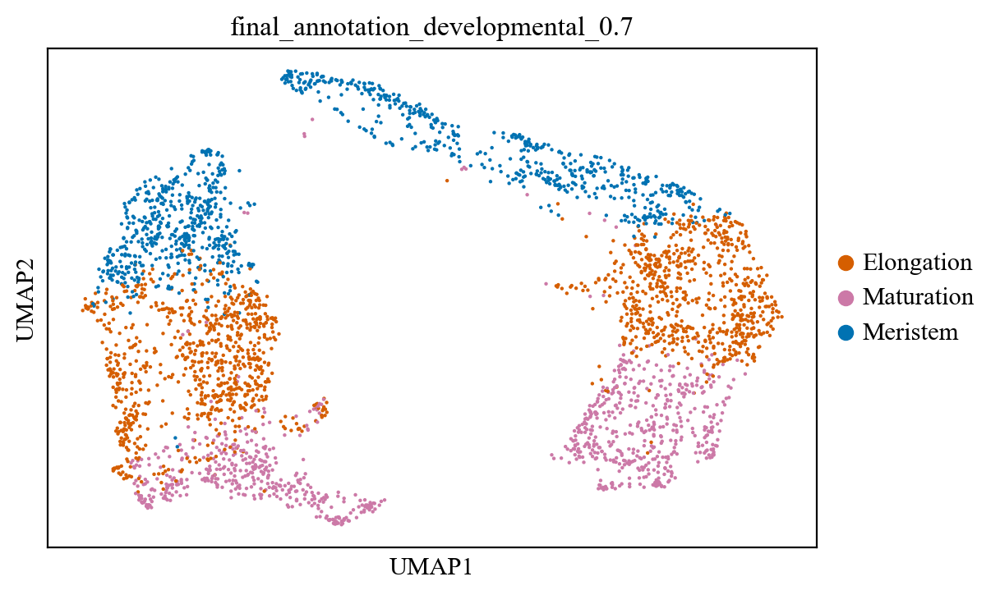

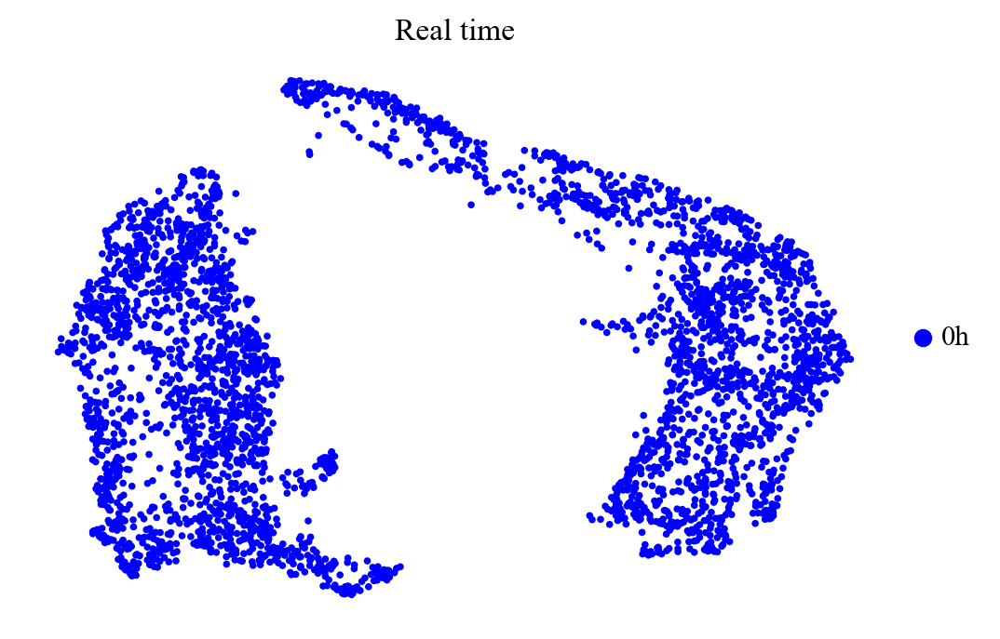

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

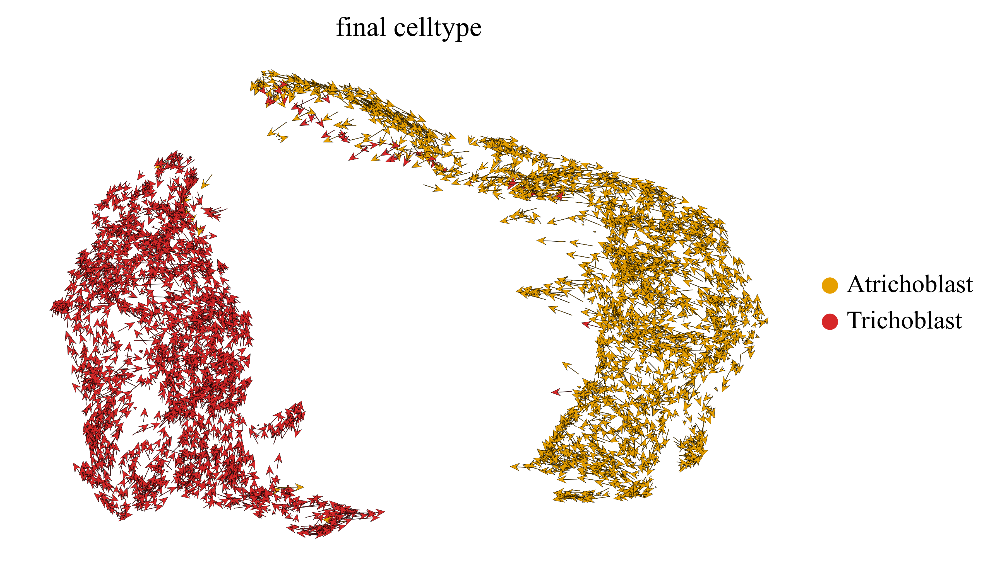

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

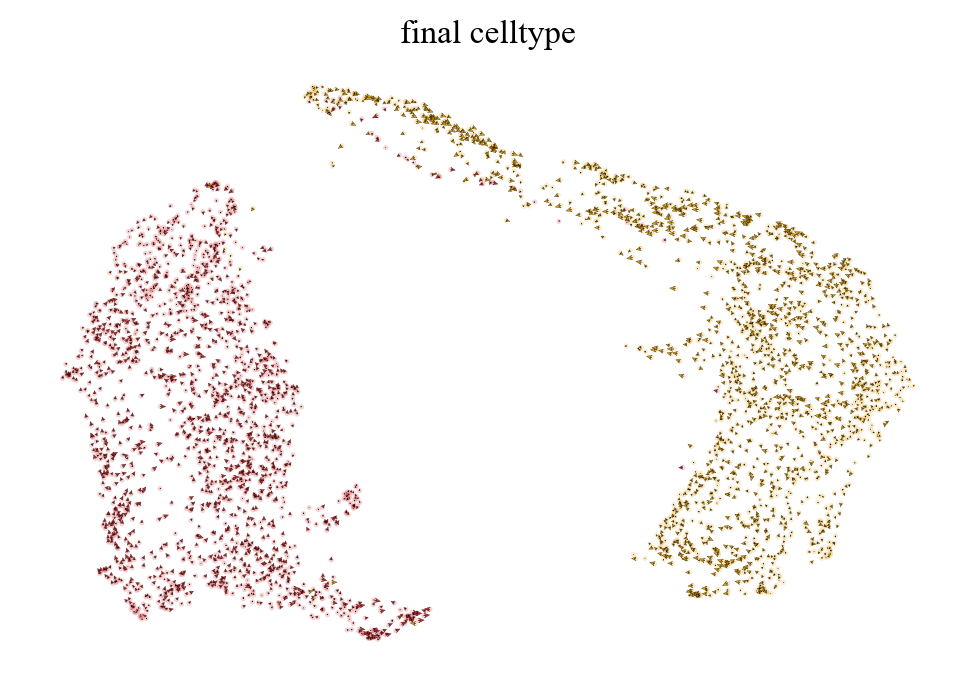

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

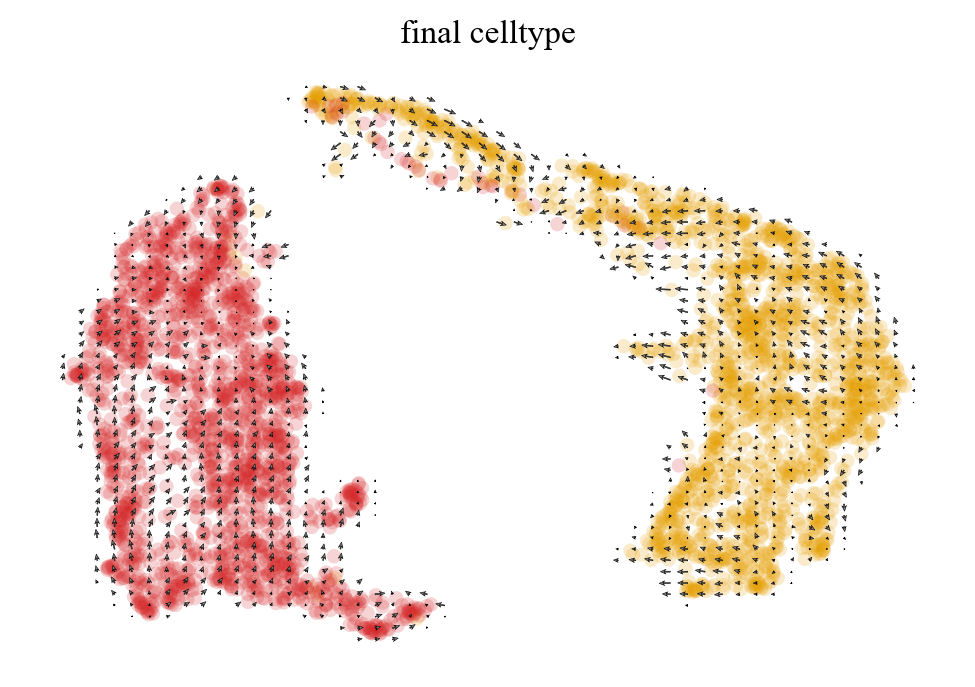

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

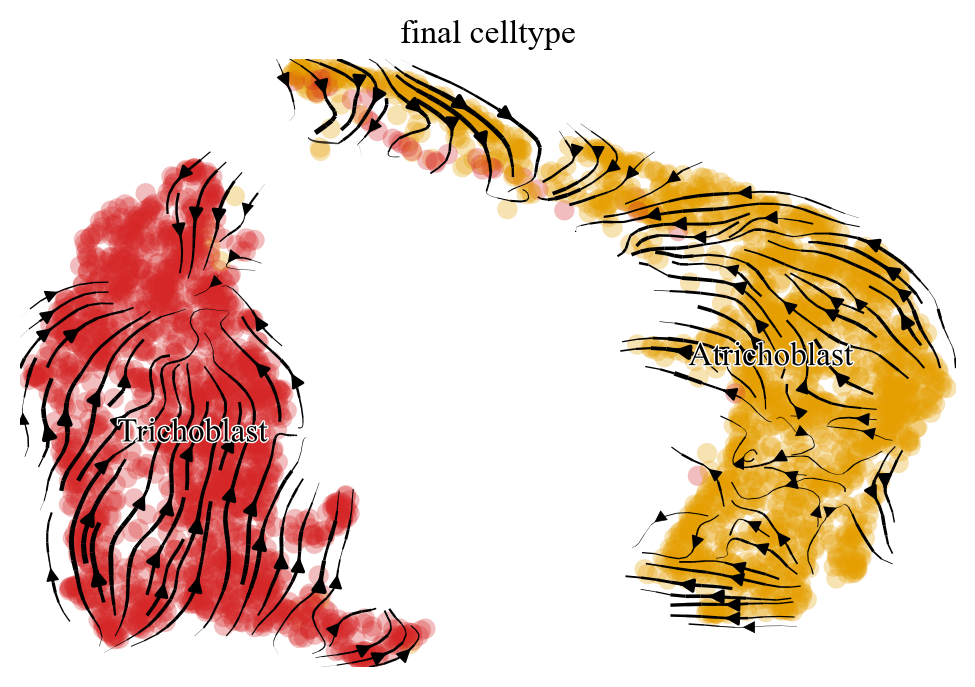

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

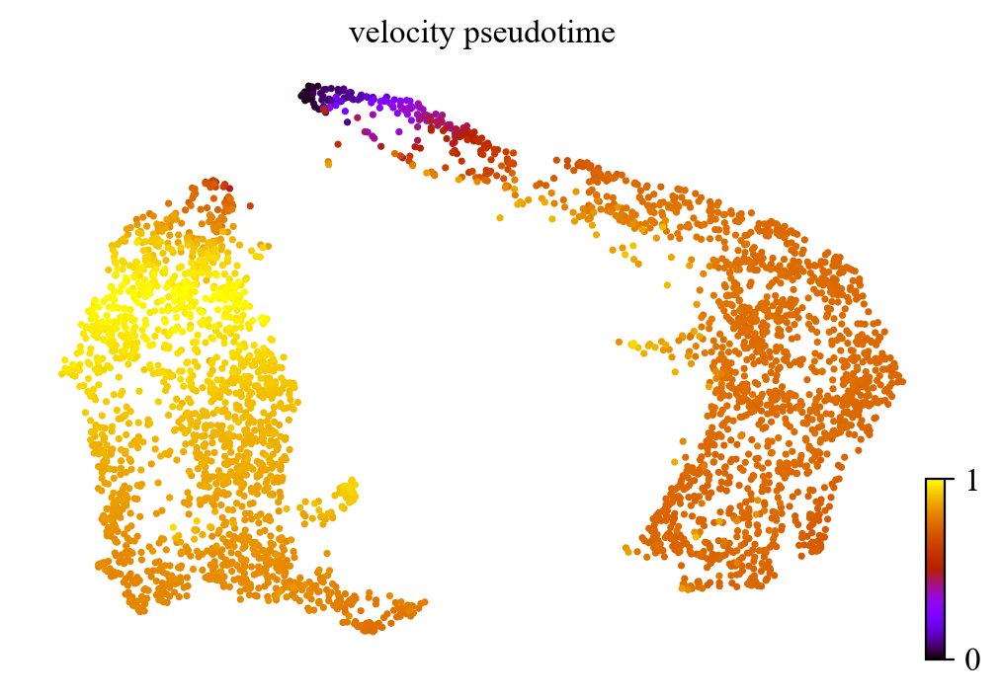

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

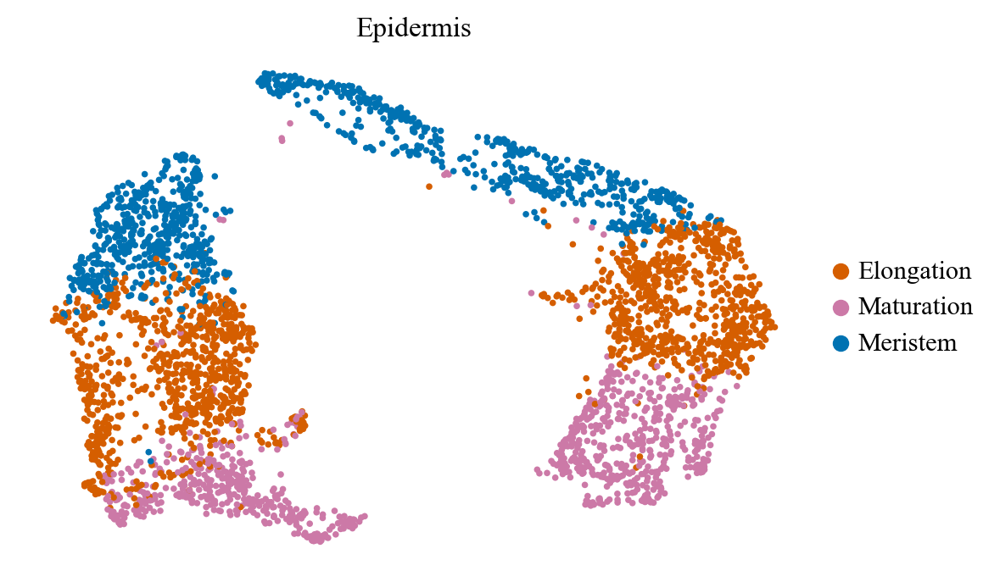

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:65: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return cat(data)  # if data is categorical/array
/lustr

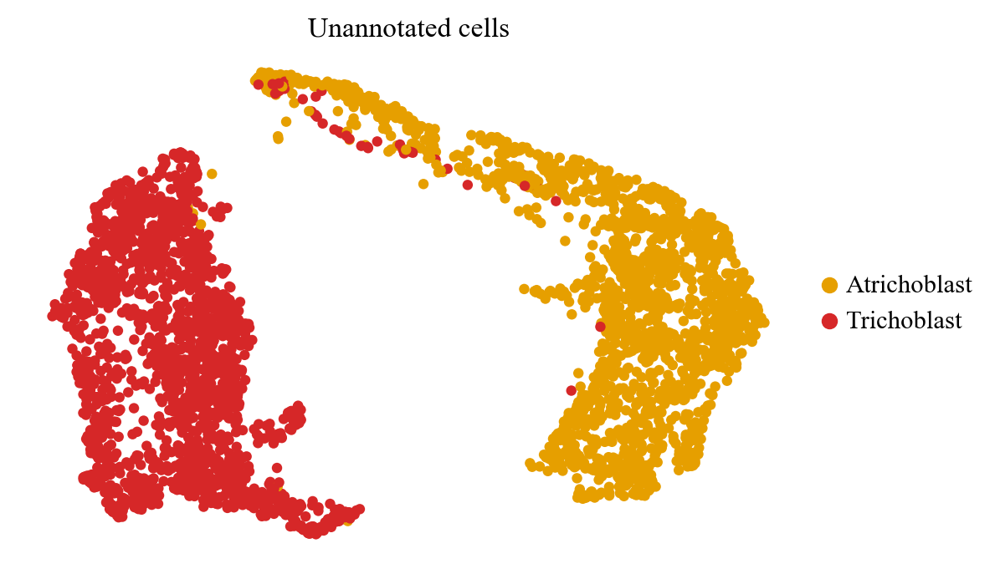

recovering dynamics (using 50/96 cores)
    finished (0:00:29) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


<Axes: title={'center': 'Latent time'}, xlabel='UMAP1', ylabel='UMAP2'>

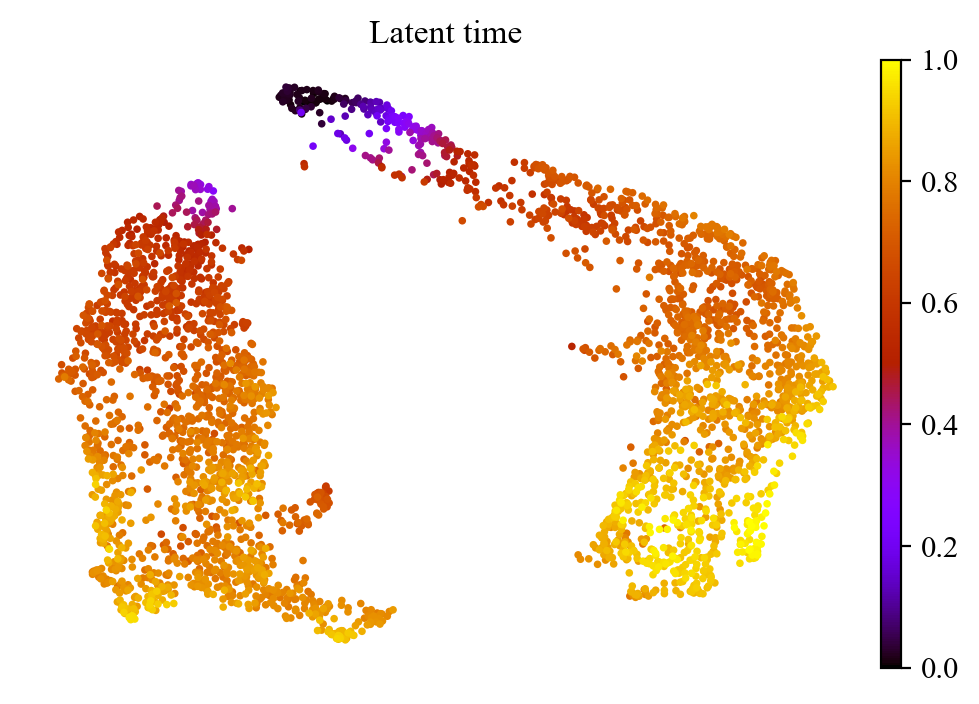

In [10]:
# Keep Unknown 0, 1, 2, 4, 5 and 6
filtered_mask_07 = (adata.obs["final_celltype"] == "Atrichoblast") | (adata.obs["final_celltype"] == "Trichoblast")
adata_filtered_07 = adata[filtered_mask_07].copy()

# Keep 4h
adata_10h = adata_filtered_07[adata_filtered_07.obs['experiment'].isin(['0h'])].copy()
print(adata_10h.obs["final_annotation_developmental_0.7"].value_counts())

# Remove batch effects
#scvi.model.SCVI.setup_anndata(adata_10h, batch_key='sample')
#model = scvi.model.SCVI(adata_10h, n_layers=2, n_latent=30, gene_likelihood="nb")

#model.to_device("cuda:0")  # Moves model to the first available GPU (which is now GPU 1)
#model.train(max_epochs=100, check_val_every_n_epoch=1)

#latent = model.get_latent_representation()
#adata_10h.obsm['X_scVI'] = latent
#adata_10h.layers['scVI'] = model.get_normalized_expression(library_size=1e4)

# Filter and normalize
scv.pp.filter_and_normalize(adata_10h, min_shared_counts=20, n_top_genes=2000)

# PCA and NN graph
#sc.pp.neighbors(adata_10h, random_state=0, use_rep="X_scVI")
sc.pp.pca(adata_10h, n_comps=30)
sc.pp.neighbors(adata_10h, n_pcs=30, n_neighbors=30, random_state=0)

# RNA velocity with dynamical mode
scv.tl.recover_dynamics(adata_10h, n_jobs=40)
scv.tl.velocity(adata_10h, mode="dynamical")
scv.tl.velocity_graph(adata_10h, n_jobs=40)

sc.tl.umap(adata_10h, min_dist=0.3)

custom_palette = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",
    "Unknown0": "blue",
    "Unknown1": "yellow", 
    "Unknown2": "green",
    "Unknown3": "pink",
    "Unknown4": "red",
    "Unknown5": "purple",
    "Unknown6": "orange",
    "Unknown7": "magenta",
    "Unknown8": "olive",
    "Unknown9": "black",
    "Unknown10": "khaki",
    "Unknown11": "darkslategrey"
}

custom_palette_developmental = {
        "Distal Columella": "#E69F00", 
        "Proximal Columella": "#56B4E9", 
        "Distal Lateral Root Cap": "#009E73", 
        "Proximal Lateral Root Cap": "#F0E442", 
        "Meristem": "#0072B2", 
        "Elongation": "#D55E00", 
        "Maturation": "#CC79A7",
        "": "#000000" 
}

sc.pl.umap(adata_10h, color="final_celltype", size=20, palette=custom_palette)
sc.pl.umap(adata_10h, color="final_celltype", size=10, palette=custom_palette, legend_loc="on data")
sc.pl.umap(adata_10h, color="final_annotation_developmental_0.7", size=10, palette=custom_palette_developmental)
sc.pl.umap(adata_10h, color="experiment", size=30, palette=['blue', 'yellow', 'pink', 'green', 'orange'], legend_loc="right margin", frameon=False, title="Real time")

# Multiple plots (different format, variables, etc)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', legend_loc ='right margin', color = "final_celltype", size = 1, arrow_length=6, arrow_size=2, dpi=300)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_grid(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_stream(adata_10h, basis='X_umap', color="final_celltype")

scv.tl.velocity_pseudotime(adata_10h)
scv.pl.scatter(adata_10h, color='velocity_pseudotime', cmap='gnuplot')
scv.pl.scatter(adata_10h, color='final_annotation_developmental_0.7', cmap='gnuplot', legend_loc="right margin", title="Epidermis", size=30)
scv.pl.scatter(adata_10h, color='final_celltype', palette=custom_palette, legend_loc="right margin", title="Unannotated cells", size=80)

scv.tl.recover_dynamics(adata_10h, n_jobs=50)
scv.tl.latent_time(adata_10h)
sc.pl.umap(adata_10h, color='latent_time', show=False, frameon=False, color_map="gnuplot", title="Latent time", size=30)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


final_annotation_developmental_0.7
Maturation    823
Name: count, dtype: int64
Epoch 100/100: 100%|██████████| 100/100 [00:10<00:00,  9.49it/s, v_num=1, train_loss_step=8537.0, train_loss_epoch=8.67e+3] 

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [00:10<00:00,  9.51it/s, v_num=1, train_loss_step=8537.0, train_loss_epoch=8.67e+3]
Filtered out 13579 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
recovering dynamics (using 40/96 cores)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:21) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing PCA
    with n_comps=30


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/tools/velocity.py:326: DeprecationWarning: Automatic neighbor calculation is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors first with Scanpy.
  moments(adata)
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/moments.py:71: DeprecationWarning: `neighbors` is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors with Scanpy.
  neighbors(
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/preprocessing/neighbors.py:233: DeprecationWarning: Automatic computation of PCA is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute PCA with Scanpy first.
  _set_pca(adata=adata, n_pcs=n_pcs, use_highly_variable=use_highly_variable)


    finished (0:00:00)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 40/96 cores)
    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:01)


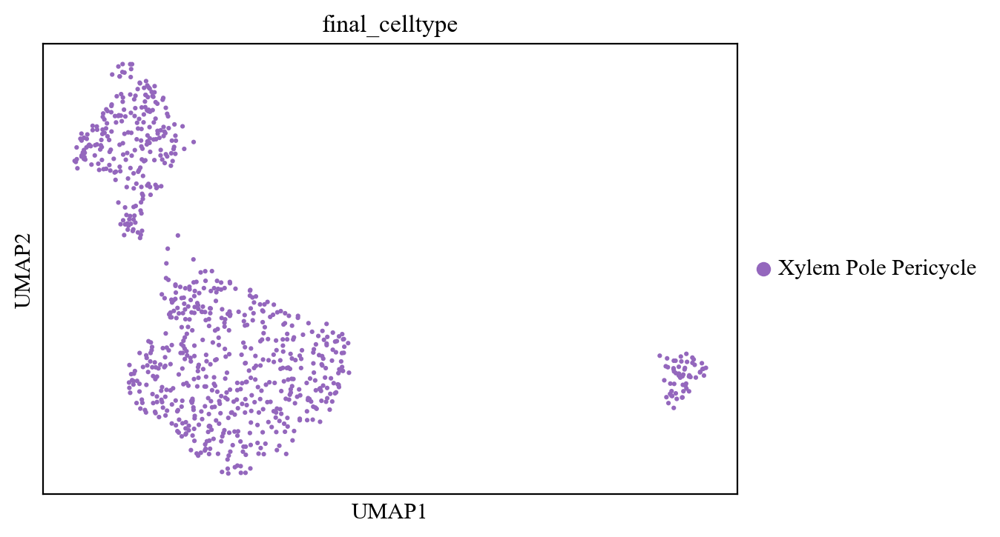

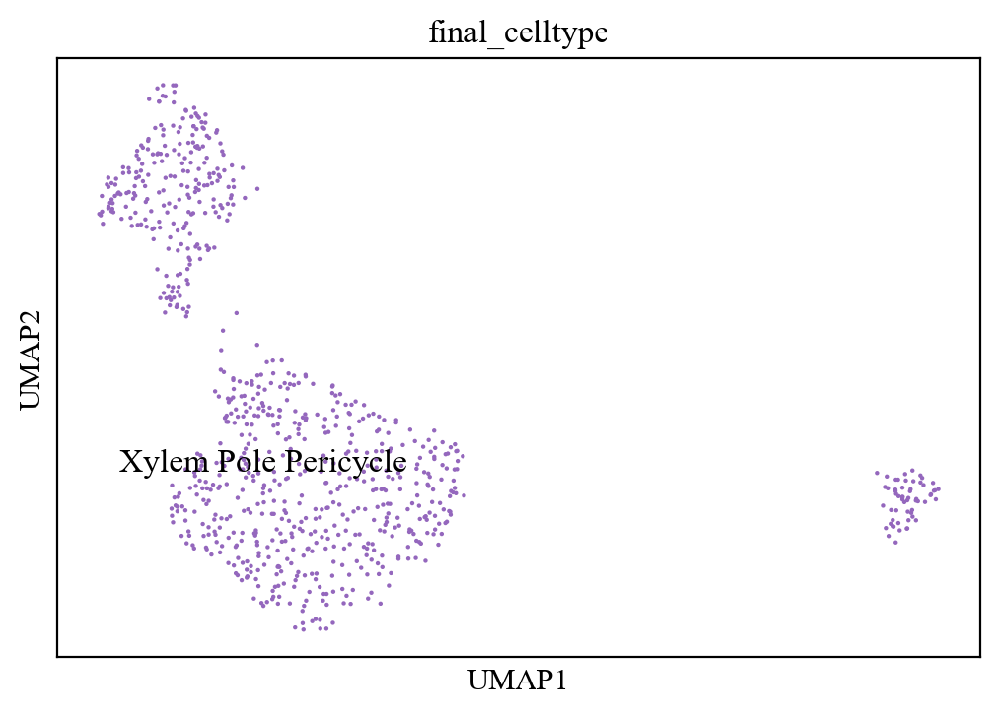

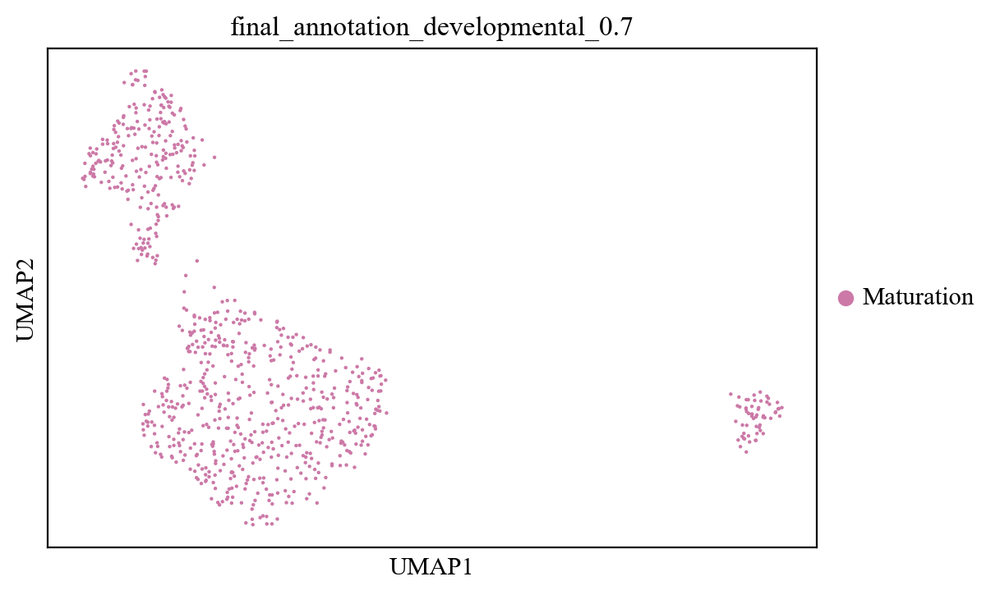

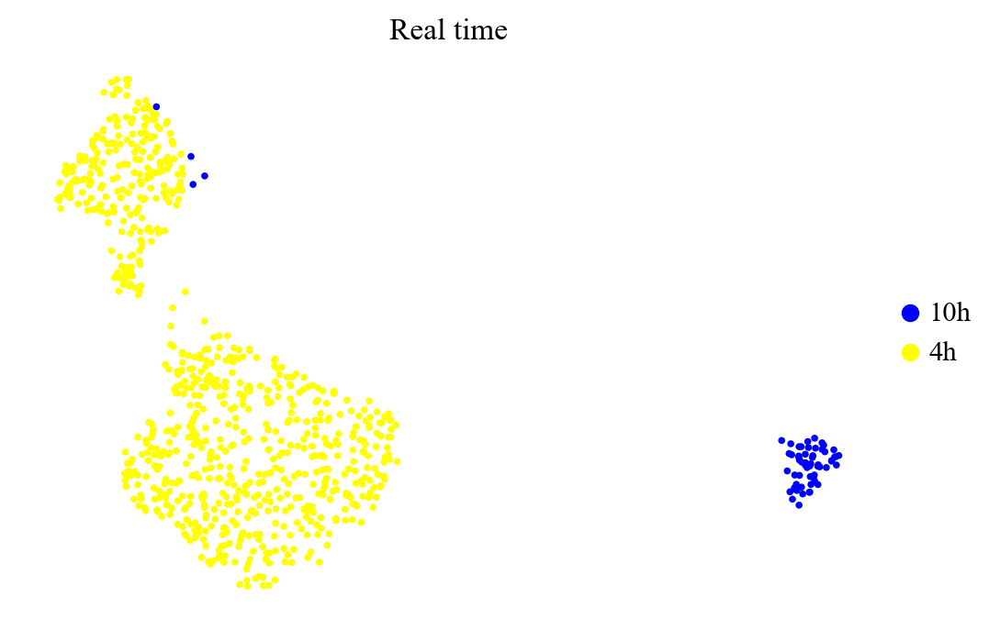

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

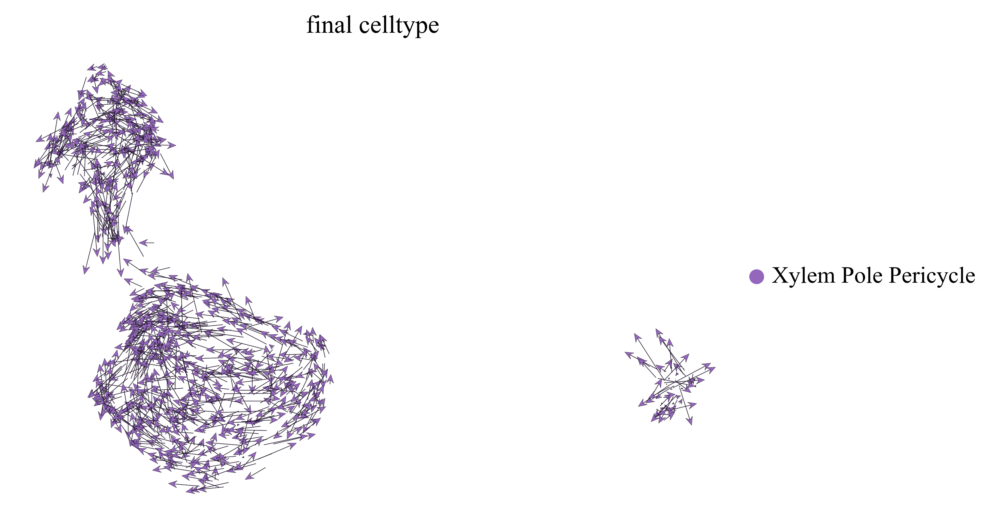

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

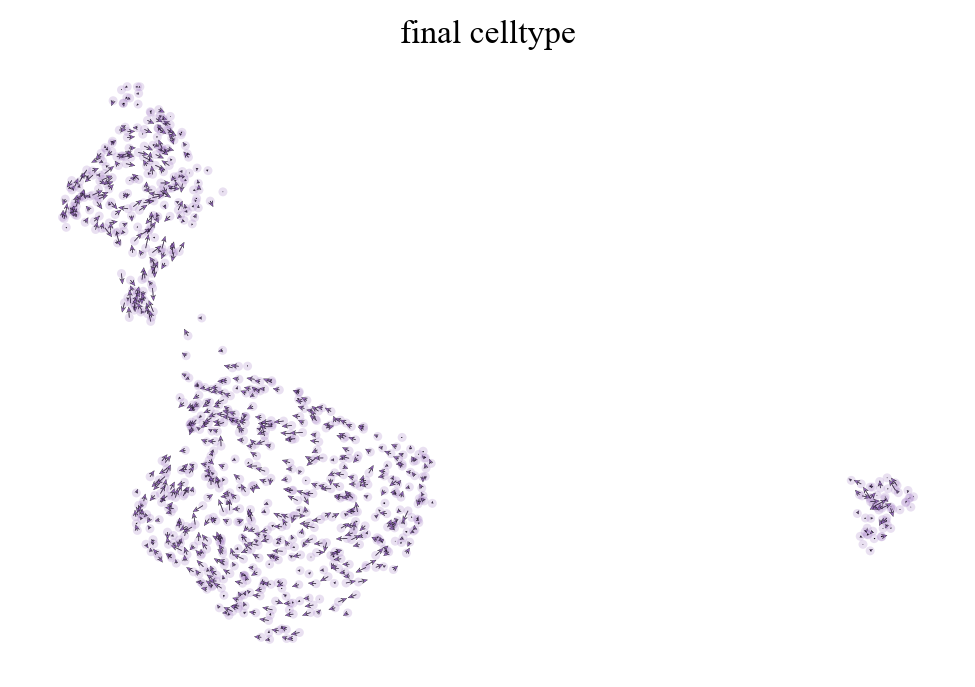

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

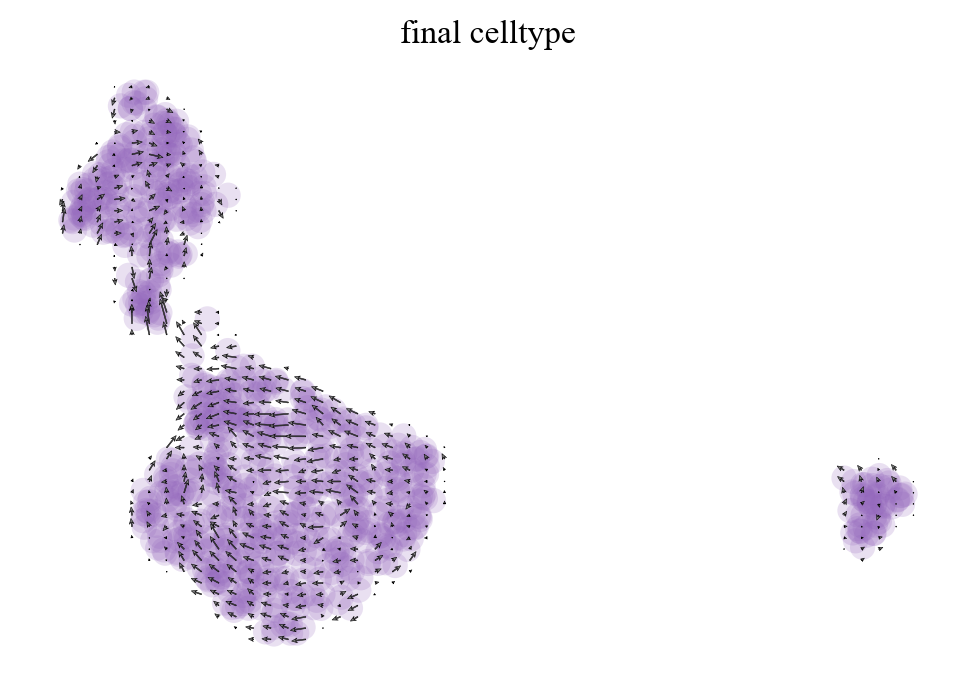

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

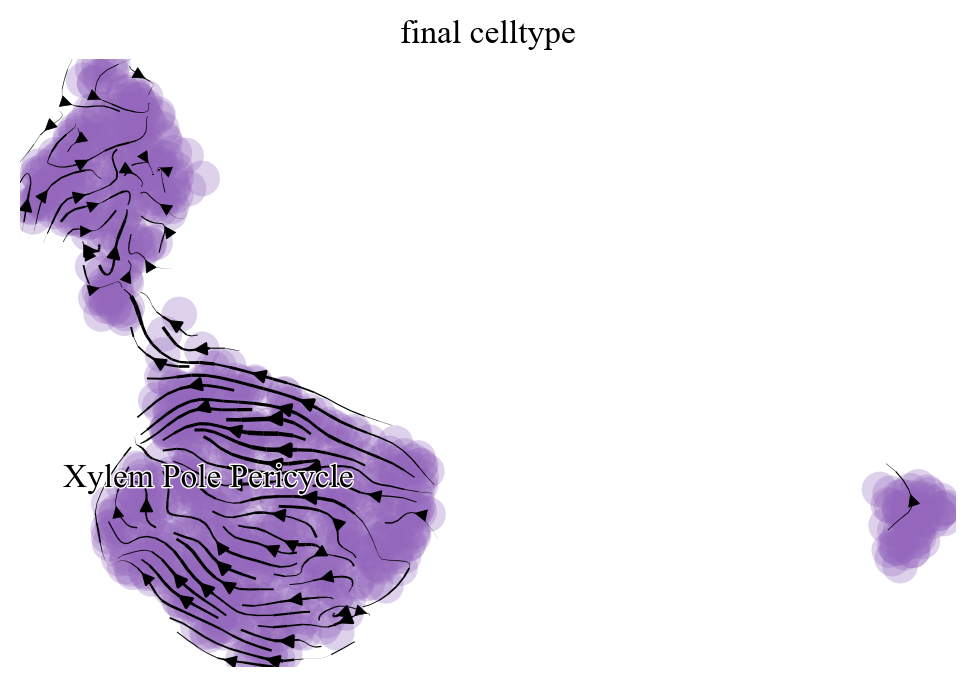

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

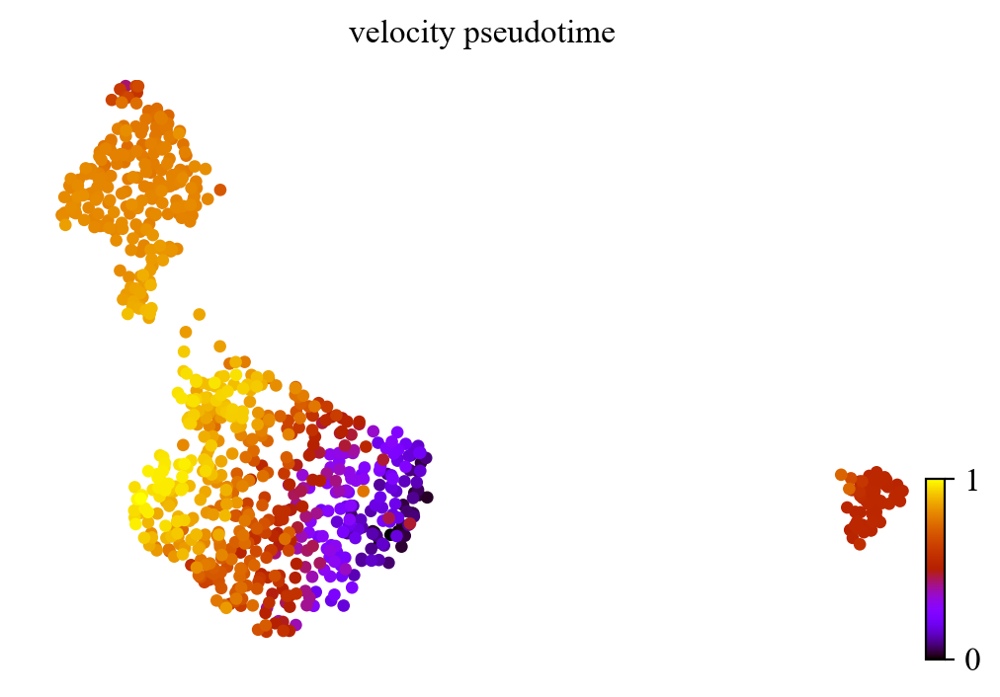

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

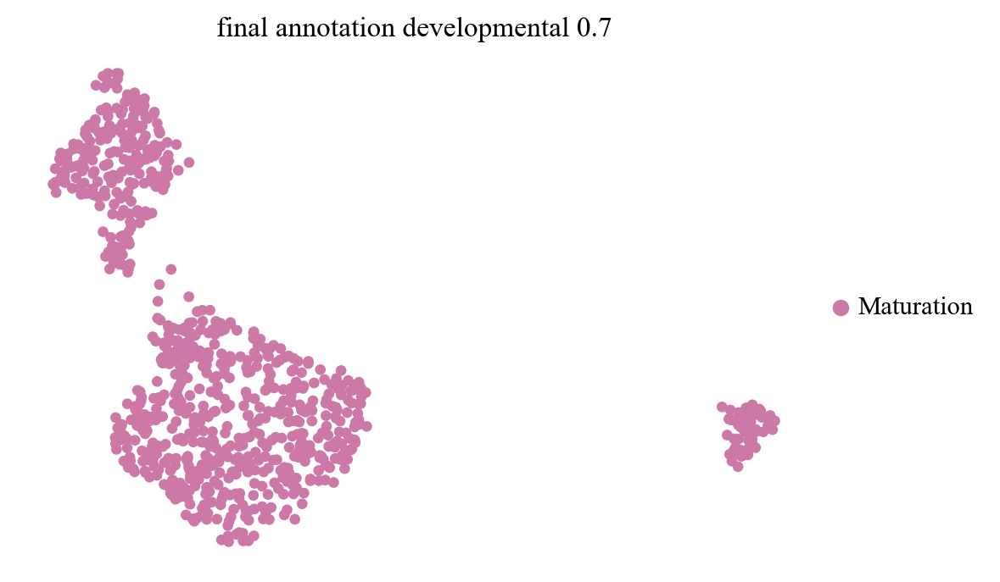

/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:65: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return cat(data)  # if data is categorical/array
/lustr

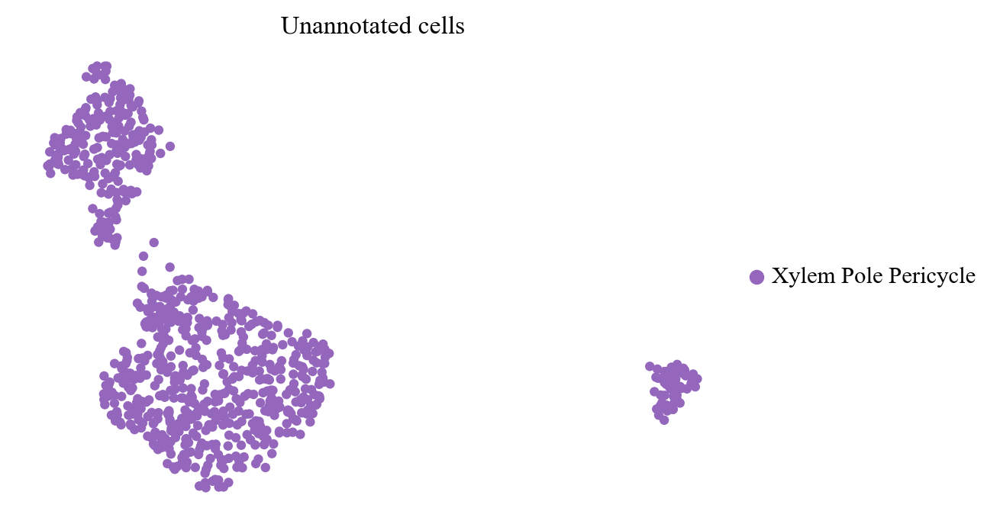

recovering dynamics (using 50/96 cores)
    finished (0:00:18) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/lustre/BIF/nobackup/perez070/miniconda3/envs/regvelo-py310/lib/python3.10/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and 

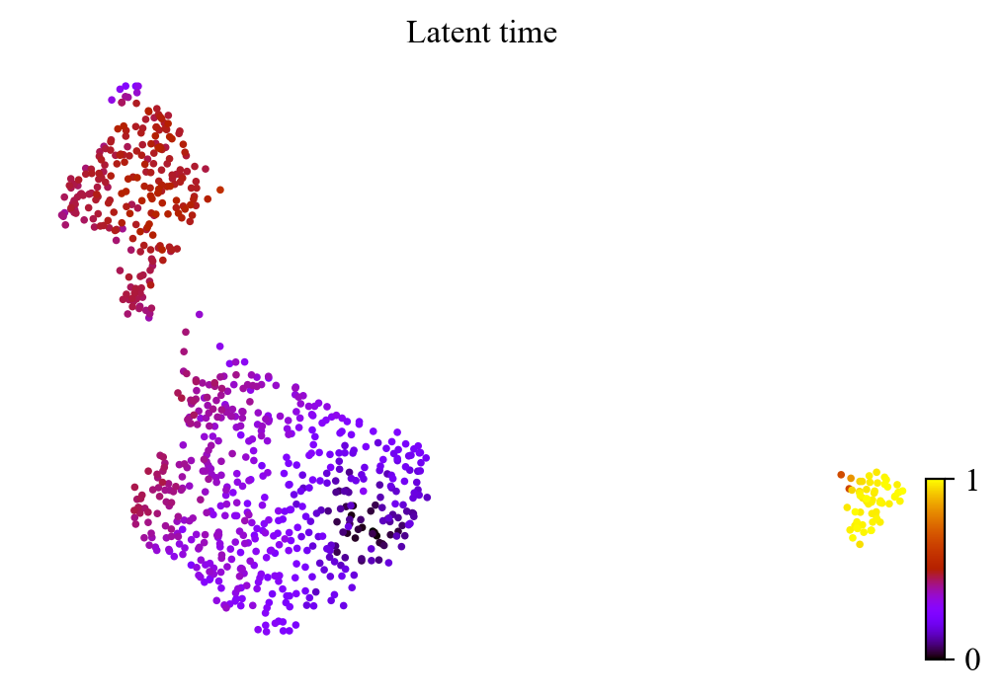

In [ ]:
# Keep Unknown 0, 1, 2, 4, 5 and 6
filtered_mask_07 = (adata.obs["final_celltype"] == "Xylem Pole Pericycle") & (adata.obs["final_annotation_developmental_0.7"] == "Meristem")
adata_filtered_07 = adata[filtered_mask_07].copy()

# Keep 4h
adata_10h = adata_filtered_07[adata_filtered_07.obs['experiment'].isin(['4h', '10h'])].copy()
print(adata_10h.obs["final_annotation_developmental_0.7"].value_counts())

# Remove batch effects
scvi.model.SCVI.setup_anndata(adata_10h, batch_key='sample')
model = scvi.model.SCVI(adata_10h, n_layers=2, n_latent=30, gene_likelihood="nb")

model.to_device("cuda:0")  # Moves model to the first available GPU (which is now GPU 1)
model.train(max_epochs=100, check_val_every_n_epoch=1)

latent = model.get_latent_representation()
adata_10h.obsm['X_scVI'] = latent
adata_10h.layers['scVI'] = model.get_normalized_expression(library_size=1e4)

# Filter and normalize
scv.pp.filter_and_normalize(adata_10h, min_shared_counts=20, n_top_genes=2000)

# PCA and NN graph
#sc.pp.pca(adata_10h, n_comps=30)
sc.pp.neighbors(adata_10h, random_state=0, use_rep="X_scVI")

# RNA velocity with dynamical mode
scv.tl.recover_dynamics(adata_10h, n_jobs=40)
scv.tl.velocity(adata_10h, mode="dynamical")
scv.tl.velocity_graph(adata_10h, n_jobs=40)

sc.tl.umap(adata_10h, min_dist=0.3)

custom_palette = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",
    "Unknown0": "blue",
    "Unknown1": "yellow", 
    "Unknown2": "green",
    "Unknown3": "pink",
    "Unknown4": "red",
    "Unknown5": "purple",
    "Unknown6": "orange",
    "Unknown7": "magenta",
    "Unknown8": "olive",
    "Unknown9": "black",
    "Unknown10": "khaki",
    "Unknown11": "darkslategrey"
}

custom_palette_developmental = {
        "Distal Columella": "#E69F00", 
        "Proximal Columella": "#56B4E9", 
        "Distal Lateral Root Cap": "#009E73", 
        "Proximal Lateral Root Cap": "#F0E442", 
        "Meristem": "#0072B2", 
        "Elongation": "#D55E00", 
        "Maturation": "#CC79A7",
        "": "#000000" 
}

sc.pl.umap(adata_10h, color="final_celltype", size=20, palette=custom_palette)
sc.pl.umap(adata_10h, color="final_celltype", size=10, palette=custom_palette, legend_loc="on data")
sc.pl.umap(adata_10h, color="final_annotation_developmental_0.7", size=10, palette=custom_palette_developmental)
sc.pl.umap(adata_10h, color="experiment", size=30, palette=['blue', 'yellow', 'pink', 'green', 'orange'], legend_loc="right margin", frameon=False, title="Real time")

# Multiple plots (different format, variables, etc)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', legend_loc ='right margin', color = "final_celltype", size = 1, arrow_length=6, arrow_size=2, dpi=300)
scv.pl.velocity_embedding(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_grid(adata_10h, basis='X_umap', color="final_celltype")
scv.pl.velocity_embedding_stream(adata_10h, basis='X_umap', color="final_celltype")

scv.tl.velocity_pseudotime(adata_10h)
scv.pl.scatter(adata_10h, color='velocity_pseudotime', cmap='gnuplot')
scv.pl.scatter(adata_10h, color='final_annotation_developmental_0.7', cmap='gnuplot', legend_loc="right")
scv.pl.scatter(adata_10h, color='final_celltype', palette=custom_palette, legend_loc="right margin", title="Unannotated cells", size=80)

scv.tl.recover_dynamics(adata_10h, n_jobs=50)
scv.tl.latent_time(adata_10h)
scv.pl.scatter(adata_10h, color='latent_time', color_map='gnuplot', title="Latent time", size=30)